# Parse benchmark results

In [1]:
!cat benchmark_results/benchmark-11_bit_mutliplexer_1000_01-rfe-8195767805351547567

Sender: LSF System <jszostek@lambda07>
Subject: Job 11186833: <rebate-benchmark-rfe-11_bit_mutliplexer_1000_01> in cluster <PMACS-SCC> Done

Job <rebate-benchmark-rfe-11_bit_mutliplexer_1000_01> was submitted from host <scisub> by user <olsonran> in cluster <PMACS-SCC>.
Job was executed on host(s) <lambda07>, in queue <moore_normal>, as user <olsonran> in cluster <PMACS-SCC>.
</home/olsonran> was used as the home directory.
</home/olsonran> was used as the working directory.
Started at Wed Mar  1 14:14:14 2017
Results reported on Wed Mar  1 14:14:26 2017

Your job looked like:

------------------------------------------------------------
# LSBATCH: User input
time python rebate-benchmarks/rfe.py /project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/11_bit_mutliplexer/11_bit_mutliplexer_1000_01.txt
------------------------------------------------------------

Successfully completed.

Resource usage summary:

    CPU time :                                  

In [2]:
def parse_output(output_filename):
    start_parsing = False
    filename = ''
    algorithm = ''
    scoring_time = ''
    variables_ranked = []
    variables_scores = []
    
    with open(output_filename) as in_file:
        for line in in_file:
            if 'The output (if any) follows:' in line:
                start_parsing = True
                continue
            
            if start_parsing:
                if '/project/moore/users/' in line:
                    filename = line.strip()
                elif 'n_features_to_select=' in line:
                    algorithm = line.strip()
                elif 'verbose=True' in line:
                    algorithm += ' ' + line.strip()
                elif 'ANOVAFValue' in line or line.strip() == 'chi2' or 'MutualInformation' in line or 'ExtraTrees' in line:
                    algorithm = line.strip()
                elif 'Completed scoring' in line:
                    scoring_time = line.split('Completed scoring in')[1].split('seconds')[0].strip()
                elif line.count('\t') == 1:
                    variables_ranked.append(line.split('\t')[0].strip())
                    variables_scores.append(line.split('\t')[1].strip())
    return filename, algorithm, scoring_time, ','.join(variables_ranked), ','.join(variables_scores)
                    
parse_output('benchmark_results/benchmark-11_bit_mutliplexer_1000_01-rfe-8195767805351547567')

('/project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/11_bit_mutliplexer/11_bit_mutliplexer_1000_01.txt',
 'RFEExtraTrees',
 '8.829363822937012',
 'R_5,A_0,A_1,A_2,R_7,R_0,R_1,R_3,R_6,R_2,R_4',
 '1,2,3,4,5,6,7,8,9,10,11')

In [3]:
from glob import glob
from tqdm import tqdm
import gzip

with gzip.open('benchmark-parsed.tsv.gz', 'w') as out_file:
    out_text = '\t'.join(['FileName', 'Algorithm', 'RunTimeSecs', 'FeaturesRanked', 'FeatureScores']) + '\n'
    out_file.write(out_text.encode('UTF-8'))
    for filename in tqdm(sorted(glob('benchmark_results/*'))):
        #if 'a_10000' in filename:
        #    continue
        
        parsed_output = parse_output(filename)
        if '/project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/GAMETES_2.2_dev_peter_mainEff_additive_4_Datasets_2Het_Loc_1_Qnt_2_Pop_100000/a_20/s_1600/h_0.4MAF_0.2/r_50/a_20s_1600_Het_h_0.4MAF_0.2_r_50_EDM-1' in parsed_output[0]:
            continue

        parser_error = False
        for output in parsed_output:
            if output == '':
                parser_error = True
                break   
        if parser_error:
            continue
        out_text = '\t'.join(parsed_output) + '\n'
        out_file.write(out_text.encode('UTF-8'))

100%|██████████| 45666/45666 [08:48<00:00, 86.36it/s]  


# Analyze benchmark results

In [36]:
import pandas as pd
import numpy as np
import sys
import csv

csv.field_size_limit(sys.maxsize)
pd.set_option('display.max_columns', None)

benchmark_data = pd.read_csv('benchmark-parsed.tsv.gz', sep='\t', engine='python')
benchmark_data['FilePath'] = benchmark_data['FileName'].apply(lambda x: '/'.join(x.split('/')[:-1]))
benchmark_data.sort_values('FilePath', inplace=True)
benchmark_data.head()

,FileName,Algorithm,RunTimeSecs,FeaturesRanked,FeatureScores,FilePath
0,/project/moore/users/ryanurb/Simulated_Benchma...,ANOVAFValue,0.000753,"R_4,R_2,R_6,R_0,R_1,R_7,R_3,R_5,A_2,A_0,A_1","18.838887844897684,14.72793572084116,14.551039...",/project/moore/users/ryanurb/Simulated_Benchma...
396,/project/moore/users/ryanurb/Simulated_Benchma...,RFEExtraTrees,11.876306,"R_2,A_1,A_2,A_0,R_0,R_7,R_6,R_5,R_3,R_4,R_1","1,2,3,4,5,6,7,8,9,10,11",/project/moore/users/ryanurb/Simulated_Benchma...
397,/project/moore/users/ryanurb/Simulated_Benchma...,"SURF(discrete_threshold=10, n_features_to_sele...",19.878675,"R_4,A_0,R_3,A_1,A_2,R_7,R_1,R_0,R_2,R_5,R_6","2986.468530565718,2650.895530996219,2513.28399...",/project/moore/users/ryanurb/Simulated_Benchma...
398,/project/moore/users/ryanurb/Simulated_Benchma...,"SURFstar(discrete_threshold=10, n_features_to_...",42.028579,"A_0,A_1,A_2,R_2,R_0,R_4,R_5,R_7,R_3,R_6,R_1","6273.743675109302,6172.067805486389,5403.26265...",/project/moore/users/ryanurb/Simulated_Benchma...
399,/project/moore/users/ryanurb/Simulated_Benchma...,ExtraTrees,1.304380,"A_2,A_1,A_0,R_2,R_0,R_6,R_5,R_7,R_3,R_4,R_1","0.16441469670173323,0.16226029779967027,0.1583...",/project/moore/users/ryanurb/Simulated_Benchma...


In [37]:
# Add random shuffling control to each dataset
import random
random.seed(1992)

random_shuffle_df = pd.DataFrame()
record_dict = {}

for dataset, dataset_group in benchmark_data.groupby('FileName'):
    first_record = dataset_group.iloc[0].copy()
    all_features = sorted(first_record['FeaturesRanked'].split(','))
    
    record_label = ','.join([dataset.split('_')[-1].split('.')[0]] + all_features)
    if record_label not in record_dict:
        random.shuffle(all_features)
        shuffled_features = ','.join(all_features)
        record_dict[record_label] = shuffled_features
    else:
        shuffled_features = record_dict[record_label]

    first_record['FeaturesRanked'] = shuffled_features
    first_record['Algorithm'] = 'Random Shuffle'
    first_record['RunTimeSecs'] = 0.
    first_record['FeatureScores'] = ','.join(['0.0'] * len(all_features))
    
    random_shuffle_df = random_shuffle_df.append(first_record)

benchmark_data = benchmark_data.append(random_shuffle_df)

''

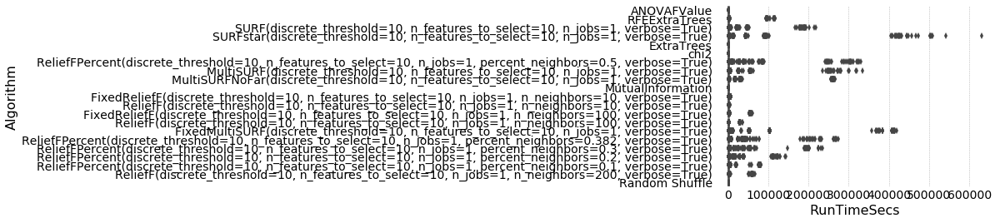

In [38]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sb

sb.boxplot(data=benchmark_data, y='Algorithm', x='RunTimeSecs')
;

In [39]:
summary_sheet = pd.read_excel('SimulatedDataArchiveSummary.xlsx')
summary_sheet['Specific Path'] = summary_sheet[
    'Specific Path'].apply(lambda x: x.replace('/home/ryanurb/idata/datasets/',
                                               '/project/moore/users/ryanurb/Simulated_Benchmark_Archive/'))
summary_sheet.head()

,Theme,Base Folder,Specific Path,Predictive Features,Total Features,Samples,Heritability,EDM,Alternate Variable,Key Variables
0,2-way Epistasis,GAMETES_2.2_dev_peter_core2wayEpistasis_Datase...,/project/moore/users/ryanurb/Simulated_Benchma...,2,20,200,0.05,Hard,None,"M0P0,M0P1"
1,2-way Epistasis,GAMETES_2.2_dev_peter_core2wayEpistasis_Datase...,/project/moore/users/ryanurb/Simulated_Benchma...,2,20,200,0.05,Easy,None,"M0P0,M0P1"
2,2-way Epistasis,GAMETES_2.2_dev_peter_core2wayEpistasis_Datase...,/project/moore/users/ryanurb/Simulated_Benchma...,2,20,200,0.10,Hard,None,"M0P0,M0P1"
3,2-way Epistasis,GAMETES_2.2_dev_peter_core2wayEpistasis_Datase...,/project/moore/users/ryanurb/Simulated_Benchma...,2,20,200,0.10,Easy,None,"M0P0,M0P1"
4,2-way Epistasis,GAMETES_2.2_dev_peter_core2wayEpistasis_Datase...,/project/moore/users/ryanurb/Simulated_Benchma...,2,20,200,0.20,Hard,None,"M0P0,M0P1"


In [40]:
benchmark_data_merged = benchmark_data.merge(summary_sheet, left_on='FilePath', right_on='Specific Path', how='left')
benchmark_data_merged.sort_values(['FilePath', 'Algorithm'], inplace=True)
benchmark_data_merged.loc[benchmark_data_merged['Key Variables'].isnull()]['FilePath'].unique()

array([], dtype=object)

In [41]:
benchmark_data.shape

(47043, 6)

In [42]:
#benchmark_data_merged.fillna('', inplace=True)

In [43]:
benchmark_data_merged['NumKeyVariables'] = benchmark_data_merged['Key Variables'].apply(lambda x: len(x.split(',')))
benchmark_data_merged.head()

,Algorithm,FeatureScores,FeaturesRanked,FileName,FilePath,RunTimeSecs,Theme,Base Folder,Specific Path,Predictive Features,Total Features,Samples,Heritability,EDM,Alternate Variable,Key Variables,NumKeyVariables
0,ANOVAFValue,"18.838887844897684,14.72793572084116,14.551039...","R_4,R_2,R_6,R_0,R_1,R_7,R_3,R_5,A_2,A_0,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000753,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3
5,ANOVAFValue,"39.039096280352084,21.137398301145616,18.25344...","R_0,R_5,R_7,R_2,R_1,R_3,R_6,R_4,A_1,A_2,A_0",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000742,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3
22,ANOVAFValue,"24.87697260957423,24.17520386879052,20.5520397...","R_4,R_3,R_1,R_7,R_0,R_5,R_6,R_2,A_0,A_2,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000725,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3
45,ANOVAFValue,"25.51774292827725,22.97295526725471,20.5018224...","R_1,R_2,R_4,R_7,R_6,R_5,R_0,R_3,A_0,A_2,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000639,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3
63,ANOVAFValue,"30.457930023982982,28.981643067371106,16.14694...","R_2,R_6,R_1,R_5,R_0,R_7,R_3,R_4,A_2,A_0,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000874,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3


In [44]:
#benchmark_data_merged['SolvedPerfect'] = benchmark_data_merged.apply(
#    lambda row: (sorted(row['FeaturesRanked'].split(',')[:row['NumKeyVariables']]) ==
#                 sorted(row['Key Variables'].split(','))), axis=1)
#benchmark_data_merged.head()

In [45]:
#benchmark_data_merged.groupby(['Algorithm', 'FilePath'])['SolvedPerfect'].mean()

In [46]:
from tqdm import tqdm

for top_pct in tqdm(list(range(101))[::-1]):
    keep_pct = 1. - (top_pct / 100.)
    benchmark_data_merged['SolvedTop{}Pct'.format(top_pct)] = benchmark_data_merged.apply(
        lambda row: set(row['Key Variables'].split(',')).issubset(
            set(row['FeaturesRanked'].split(',')[
                :max(row['NumKeyVariables'], int(keep_pct * row['Total Features']))])), axis=1)

benchmark_data_merged.head()

100%|██████████| 101/101 [11:53<00:00, 10.36s/it]


,Algorithm,FeatureScores,FeaturesRanked,FileName,FilePath,RunTimeSecs,Theme,Base Folder,Specific Path,Predictive Features,Total Features,Samples,Heritability,EDM,Alternate Variable,Key Variables,NumKeyVariables,SolvedTop100Pct,SolvedTop99Pct,SolvedTop98Pct,SolvedTop97Pct,SolvedTop96Pct,SolvedTop95Pct,SolvedTop94Pct,SolvedTop93Pct,SolvedTop92Pct,SolvedTop91Pct,SolvedTop90Pct,SolvedTop89Pct,SolvedTop88Pct,SolvedTop87Pct,SolvedTop86Pct,SolvedTop85Pct,SolvedTop84Pct,SolvedTop83Pct,SolvedTop82Pct,SolvedTop81Pct,SolvedTop80Pct,SolvedTop79Pct,SolvedTop78Pct,SolvedTop77Pct,SolvedTop76Pct,SolvedTop75Pct,SolvedTop74Pct,SolvedTop73Pct,SolvedTop72Pct,SolvedTop71Pct,SolvedTop70Pct,SolvedTop69Pct,SolvedTop68Pct,SolvedTop67Pct,SolvedTop66Pct,SolvedTop65Pct,SolvedTop64Pct,SolvedTop63Pct,SolvedTop62Pct,SolvedTop61Pct,SolvedTop60Pct,SolvedTop59Pct,SolvedTop58Pct,SolvedTop57Pct,SolvedTop56Pct,SolvedTop55Pct,SolvedTop54Pct,SolvedTop53Pct,SolvedTop52Pct,SolvedTop51Pct,SolvedTop50Pct,SolvedTop49Pct,SolvedTop48Pct,SolvedTop47Pct,SolvedTop46Pct,SolvedTop45Pct,SolvedTop44Pct,SolvedTop43Pct,SolvedTop42Pct,SolvedTop41Pct,SolvedTop40Pct,SolvedTop39Pct,SolvedTop38Pct,SolvedTop37Pct,SolvedTop36Pct,SolvedTop35Pct,SolvedTop34Pct,SolvedTop33Pct,SolvedTop32Pct,SolvedTop31Pct,SolvedTop30Pct,SolvedTop29Pct,SolvedTop28Pct,SolvedTop27Pct,SolvedTop26Pct,SolvedTop25Pct,SolvedTop24Pct,SolvedTop23Pct,SolvedTop22Pct,SolvedTop21Pct,SolvedTop20Pct,SolvedTop19Pct,SolvedTop18Pct,SolvedTop17Pct,SolvedTop16Pct,SolvedTop15Pct,SolvedTop14Pct,SolvedTop13Pct,SolvedTop12Pct,SolvedTop11Pct,SolvedTop10Pct,SolvedTop9Pct,SolvedTop8Pct,SolvedTop7Pct,SolvedTop6Pct,SolvedTop5Pct,SolvedTop4Pct,SolvedTop3Pct,SolvedTop2Pct,SolvedTop1Pct,SolvedTop0Pct
0,ANOVAFValue,"18.838887844897684,14.72793572084116,14.551039...","R_4,R_2,R_6,R_0,R_1,R_7,R_3,R_5,A_2,A_0,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000753,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
5,ANOVAFValue,"39.039096280352084,21.137398301145616,18.25344...","R_0,R_5,R_7,R_2,R_1,R_3,R_6,R_4,A_1,A_2,A_0",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000742,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
22,ANOVAFValue,"24.87697260957423,24.17520386879052,20.5520397...","R_4,R_3,R_1,R_7,R_0,R_5,R_6,R_2,A_0,A_2,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000725,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3,False,False,False,Fals

In [47]:
benchmark_data_merged.to_csv('benchmark-parsed-merged-analyzed.tsv.gz', index=False, compression='gzip', sep='\t')

# Visualize benchmark results

In [48]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import sys
import csv

plt.style.use('https://gist.githubusercontent.com/rhiever/a4fb39bfab4b33af0018/raw/b25b4ba478c2e163dd54fd5600e80ca7453459da/tableau20.mplstyle')

csv.field_size_limit(sys.maxsize)
pd.set_option('display.max_columns', None)

benchmark_data_merged = pd.read_csv('benchmark-parsed-merged-analyzed.tsv.gz',
                                    compression='gzip', sep='\t', engine='python')
benchmark_data_merged.sort_values(['FilePath', 'Algorithm'], inplace=True)
benchmark_data_merged.head()

/Users/randal_olson/anaconda/lib/python3.6/site-packages/matplotlib/__init__.py:913: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


,Algorithm,FeatureScores,FeaturesRanked,FileName,FilePath,RunTimeSecs,Theme,Base Folder,Specific Path,Predictive Features,Total Features,Samples,Heritability,EDM,Alternate Variable,Key Variables,NumKeyVariables,SolvedTop100Pct,SolvedTop99Pct,SolvedTop98Pct,SolvedTop97Pct,SolvedTop96Pct,SolvedTop95Pct,SolvedTop94Pct,SolvedTop93Pct,SolvedTop92Pct,SolvedTop91Pct,SolvedTop90Pct,SolvedTop89Pct,SolvedTop88Pct,SolvedTop87Pct,SolvedTop86Pct,SolvedTop85Pct,SolvedTop84Pct,SolvedTop83Pct,SolvedTop82Pct,SolvedTop81Pct,SolvedTop80Pct,SolvedTop79Pct,SolvedTop78Pct,SolvedTop77Pct,SolvedTop76Pct,SolvedTop75Pct,SolvedTop74Pct,SolvedTop73Pct,SolvedTop72Pct,SolvedTop71Pct,SolvedTop70Pct,SolvedTop69Pct,SolvedTop68Pct,SolvedTop67Pct,SolvedTop66Pct,SolvedTop65Pct,SolvedTop64Pct,SolvedTop63Pct,SolvedTop62Pct,SolvedTop61Pct,SolvedTop60Pct,SolvedTop59Pct,SolvedTop58Pct,SolvedTop57Pct,SolvedTop56Pct,SolvedTop55Pct,SolvedTop54Pct,SolvedTop53Pct,SolvedTop52Pct,SolvedTop51Pct,SolvedTop50Pct,SolvedTop49Pct,SolvedTop48Pct,SolvedTop47Pct,SolvedTop46Pct,SolvedTop45Pct,SolvedTop44Pct,SolvedTop43Pct,SolvedTop42Pct,SolvedTop41Pct,SolvedTop40Pct,SolvedTop39Pct,SolvedTop38Pct,SolvedTop37Pct,SolvedTop36Pct,SolvedTop35Pct,SolvedTop34Pct,SolvedTop33Pct,SolvedTop32Pct,SolvedTop31Pct,SolvedTop30Pct,SolvedTop29Pct,SolvedTop28Pct,SolvedTop27Pct,SolvedTop26Pct,SolvedTop25Pct,SolvedTop24Pct,SolvedTop23Pct,SolvedTop22Pct,SolvedTop21Pct,SolvedTop20Pct,SolvedTop19Pct,SolvedTop18Pct,SolvedTop17Pct,SolvedTop16Pct,SolvedTop15Pct,SolvedTop14Pct,SolvedTop13Pct,SolvedTop12Pct,SolvedTop11Pct,SolvedTop10Pct,SolvedTop9Pct,SolvedTop8Pct,SolvedTop7Pct,SolvedTop6Pct,SolvedTop5Pct,SolvedTop4Pct,SolvedTop3Pct,SolvedTop2Pct,SolvedTop1Pct,SolvedTop0Pct
0,ANOVAFValue,"18.838887844897684,14.72793572084116,14.551039...","R_4,R_2,R_6,R_0,R_1,R_7,R_3,R_5,A_2,A_0,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000753,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
1,ANOVAFValue,"39.039096280352084,21.137398301145616,18.25344...","R_0,R_5,R_7,R_2,R_1,R_3,R_6,R_4,A_1,A_2,A_0",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000742,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
2,ANOVAFValue,"24.87697260957423,24.17520386879052,20.5520397...","R_4,R_3,R_1,R_7,R_0,R_5,R_6,R_2,A_0,A_2,A_1",/project/moore/users/ryanurb/Simulated_Benchma...,/project/moore/users/ryanurb/Simulated_Benchma...,0.000725,11_bit_mutliplexer,11_bit_mutliplexer,/project/moore/users/ryanurb/Simulated_Benchma...,11,11,1000,1.0,None,None,"A_0,A_1,A_2",3,False,False,False,False

## Make sure all of the results are in

In [49]:
results_summary = benchmark_data_merged.groupby('FilePath')['FilePath'].count()
results_summary.sort_values()

FilePath
/project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/GAMETES_2.2_dev_peter_2wayEpi_NA_Datasets_Loc_2_Qnt_2_Pop_100000/a_20/s_1600/her_0.4__maf_0.2/NA_0.1/a_20s_1600her_0.4__maf_0.2_EDM-2                   480
/project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/GAMETES_2.2_dev_peter_2wayEpi_NA_Datasets_Loc_2_Qnt_2_Pop_100000/a_20/s_1600/her_0.4__maf_0.2/NA_0.5/a_20s_1600her_0.4__maf_0.2_EDM-2                   480
/project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/GAMETES_2.2_dev_peter_2wayEpi_NA_Datasets_Loc_2_Qnt_2_Pop_100000/a_20/s_1600/her_0.4__maf_0.2/NA_0.01/a_20s_1600her_0.4__maf_0.2_EDM-2                  480
/project/moore/users/ryanurb/Simulated_Benchmark_Archive/Simulated_Benchmark_Archive/GAMETES_2.2_dev_peter_2wayEpi_NA_Datasets_Loc_2_Qnt_2_Pop_100000/a_20/s_1600/her_0.4__maf_0.2/NA_0.001/a_20s_1600her_0.4__maf_0.2_EDM-2                 480
/project/moore/users/ryanur

In [50]:
benchmark_data_merged.groupby('Theme')['Theme'].count()

Theme
1 Main Effect                                  5040
11_bit_mutliplexer                              630
135_bit_mutliplexer                             630
2 Additive Main Effects                        1260
2-way Epistasis                               20160
20_bit_mutliplexer                              630
3 Class Balanced Data (2-way Epistasis+ME)      630
3-way Epistasis (GAMETES)                       630
37_bit_mutliplexer                              630
4 Additive Main Effects                         630
6_bit_mutliplexer                               636
70_bit_mutliplexer                              630
9 Class Balanced Data (2-way Epistasis+ME)      630
Additive Interactions                          1260
Continuous Endpoints (GAMETES)                 1800
Continuous Endpoints (Threshold)                600
Continuous Features                             630
Heterogeneity                                  1260
Imbalanced Data                                1260
Missin

In [51]:
benchmark_data_merged['AlgorithmShort'] = benchmark_data_merged['Algorithm'].apply(lambda x: x.split('(')[0])
benchmark_data_merged['AlgorithmShort'] += benchmark_data_merged[
    'Algorithm'].apply(lambda x:
                       ('-NN10' if 'n_neighbors=10,' in x else
                        '-NN100' if 'n_neighbors=100,' in x else
                        '-NN200' if 'n_neighbors=200,' in x else
                        '10' if 'percent_neighbors=0.1,' in x else
                        '20' if 'percent_neighbors=0.2,' in x else
                        '30' if 'percent_neighbors=0.3,' in x else
                        '38.2' if 'percent_neighbors=0.382,' in x else
                        '50' if 'percent_neighbors=0.5,' in x else ''))

benchmark_data_merged['AlgorithmShort'] = benchmark_data_merged[
    'AlgorithmShort'].apply(lambda x:
                            x.replace('ReliefFPercent', 'FixedReliefFPercent'))

benchmark_data_merged['AlgorithmShort'] = benchmark_data_merged[
    'AlgorithmShort'].apply(lambda x:
                            ('MultiSURF*' if x == 'MultiSURF' else
                             'MultiSURF' if x == 'MultiSURFNoFar' else x))


sorted(benchmark_data_merged['AlgorithmShort'].unique())

['ANOVAFValue',
 'ExtraTrees',
 'FixedMultiSURF',
 'FixedReliefF-NN10',
 'FixedReliefF-NN100',
 'FixedReliefFPercent10',
 'FixedReliefFPercent20',
 'FixedReliefFPercent30',
 'FixedReliefFPercent38.2',
 'FixedReliefFPercent50',
 'MultiSURF',
 'MultiSURF*',
 'MutualInformation',
 'RFEExtraTrees',
 'Random Shuffle',
 'ReliefF-NN10',
 'ReliefF-NN100',
 'ReliefF-NN200',
 'SURF',
 'SURFstar',
 'chi2']

## Comparing ReliefF variations

**FixedReliefF-NN10**: ReliefF taking the 10 nearest neighbors (10 nearest matches & 10 nearest misses)

**FixedReliefF-NN100**: ReliefF taking the 100 nearest neighbors (100 nearest matches & 100 nearest misses)

**ReliefF-NN10**: ReliefF taking the 10 nearest neighbors (regardless of match/miss)

**ReliefF-NN100**: ReliefF taking the 100 nearest neighbors (regardless of match/miss)

**ReliefF-NN200**: ReliefF taking the 200 nearest neighbors (regardless of match/miss)

**FixedReliefFPercent10**: ReliefF taking 10% of the data set size nearest neighbors (5% matches & 5% misses)

**FixedReliefFPercent20**: ReliefF taking 20% of the data set size nearest neighbors (1% matches & 1% misses)

**FixedReliefFPercent30**: ReliefF taking 30% of the data set size nearest neighbors (15% matches & 15% misses)

**FixedReliefFPercent38.2**: ReliefF taking 38.2% of the data set size nearest neighbors (19.1% matches & 19.1% misses)

**FixedReliefFPercent50**: ReliefF taking 50% of the data set size nearest neighbors (25% matches & 25% misses)

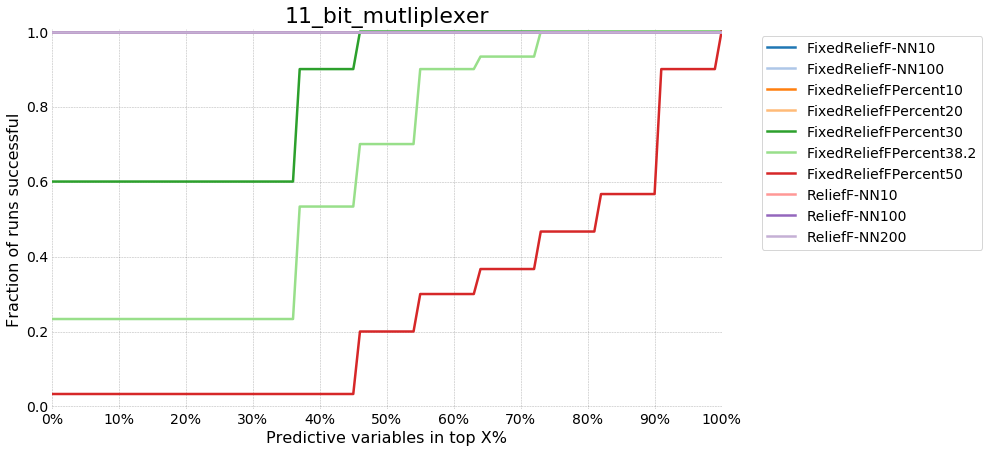

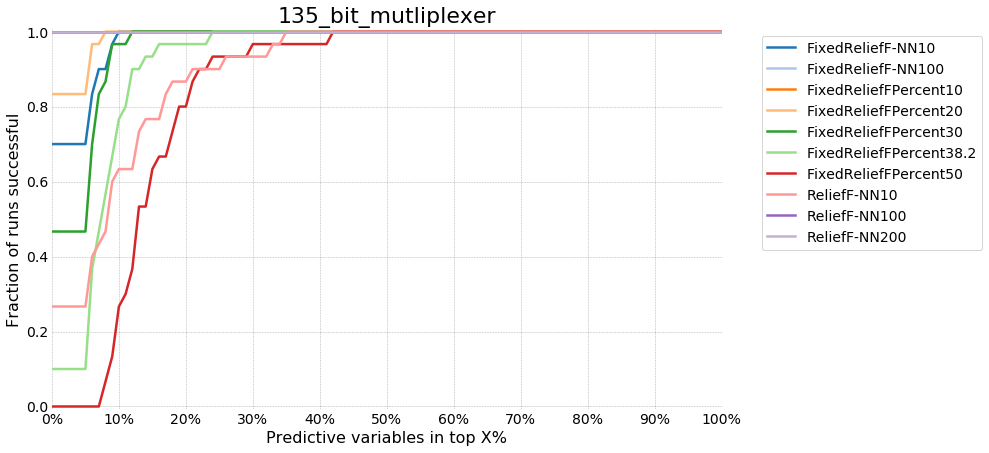

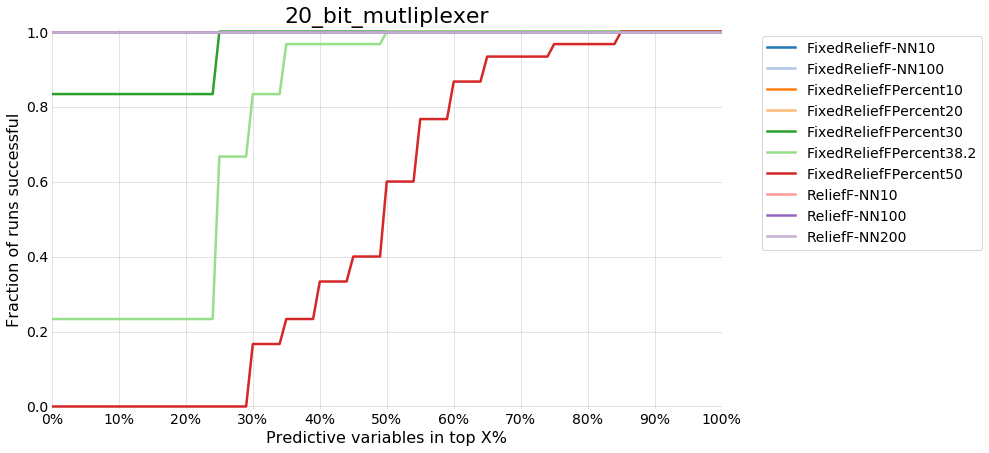

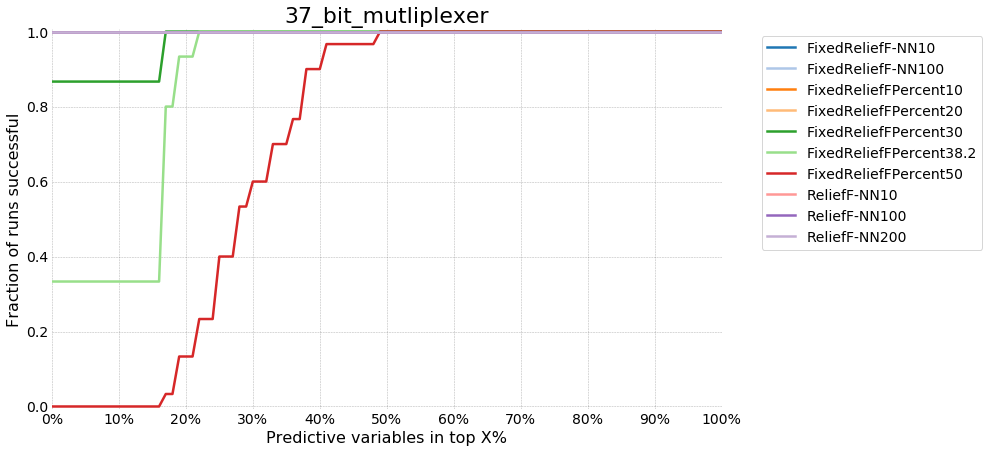

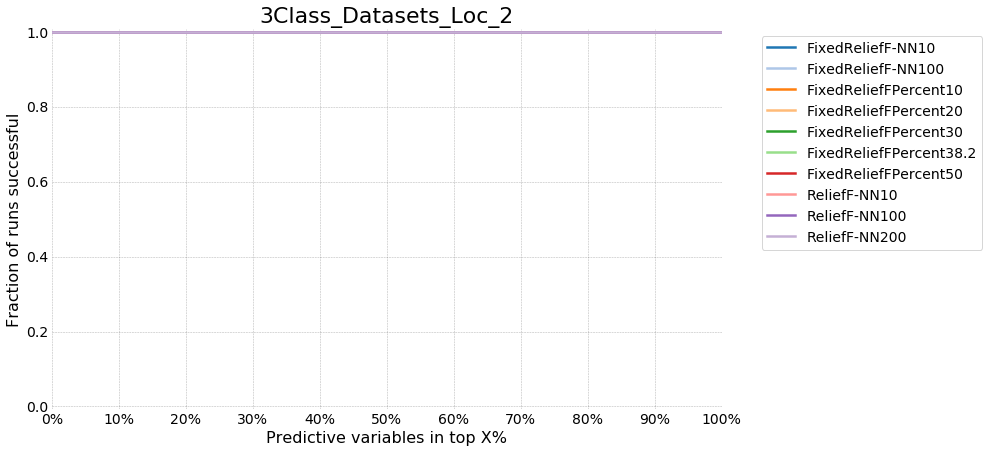

...

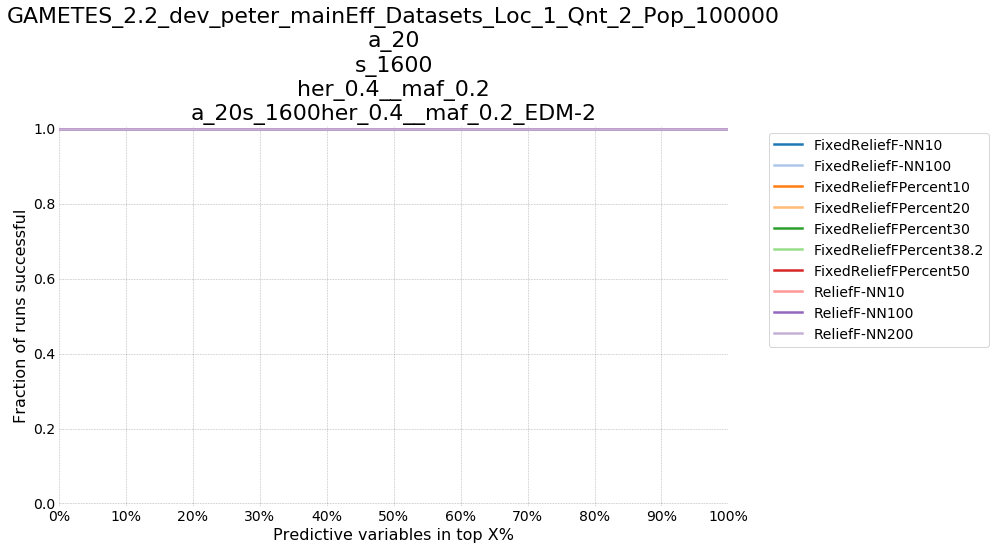

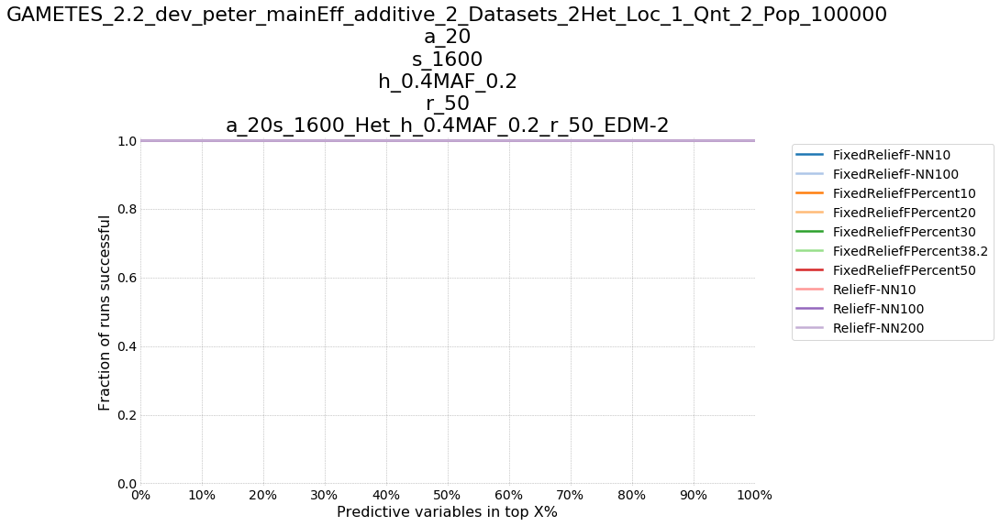

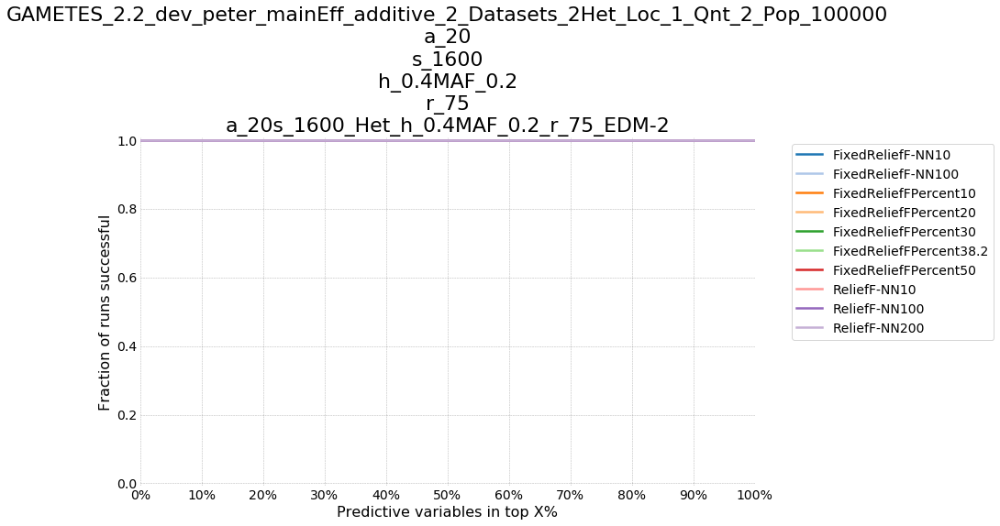

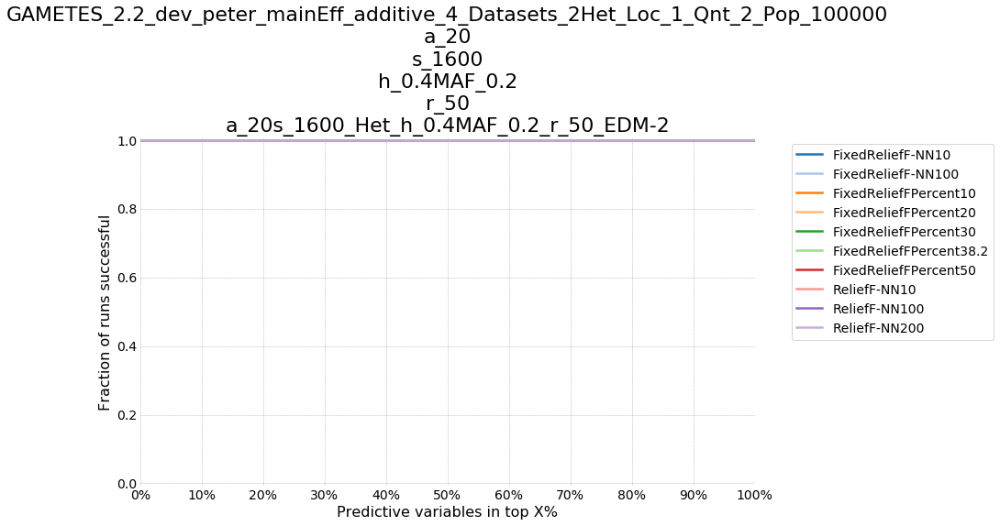

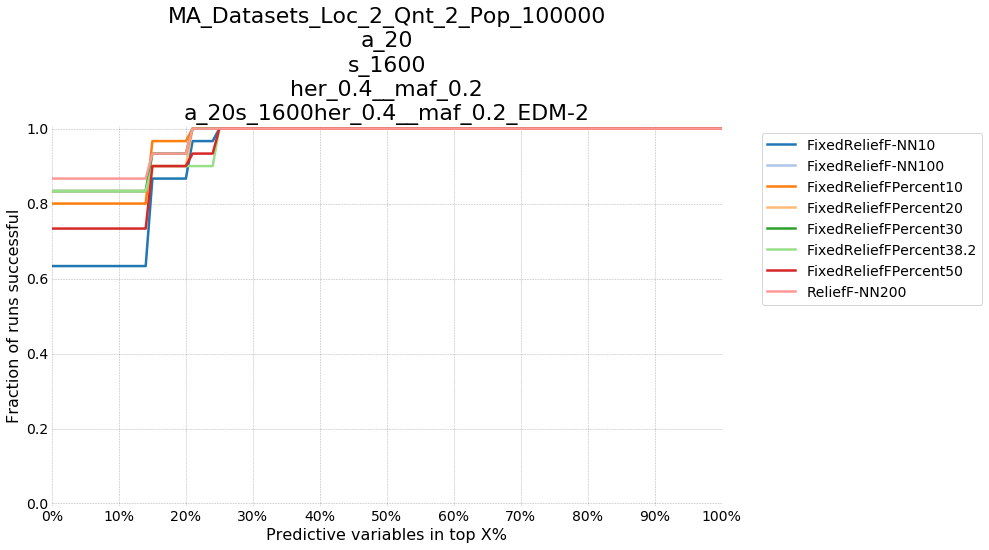

In [6]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

for problem, problem_group in benchmark_data_merged.groupby('FilePath'):
    problem_group_avg = problem_group.groupby('AlgorithmShort')[solved_cols].mean()
    #print(problem_group_avg.index.values)
    #print(problem_group_avg.columns.values)
    #print(problem_group_avg.values)
    
    plt.figure()
    for algorithm, vals in zip(problem_group_avg.index.values, problem_group_avg.values):
        if 'ReliefF' not in algorithm:
            continue
        plt.plot(list(range(101)), vals, label=algorithm)

    plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))
    
    plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])
    
    plt.ylim(-0.0075, 1.0075)
    plt.xlim(0, 100)
    
    plt.ylabel('Fraction of runs successful')
    plt.xlabel('Predictive variables in top X%')
    plt.title('\n'.join(problem.split('Archive/')[-1].split('/')))

## Comparing ReliefF variations with same # neighbors

**FixedReliefF-NN100**: ReliefF taking the 100 nearest neighbors (100 nearest matches & 100 nearest misses)

**ReliefF-NN200**: ReliefF taking the 200 nearest neighbors (regardless of match/miss)

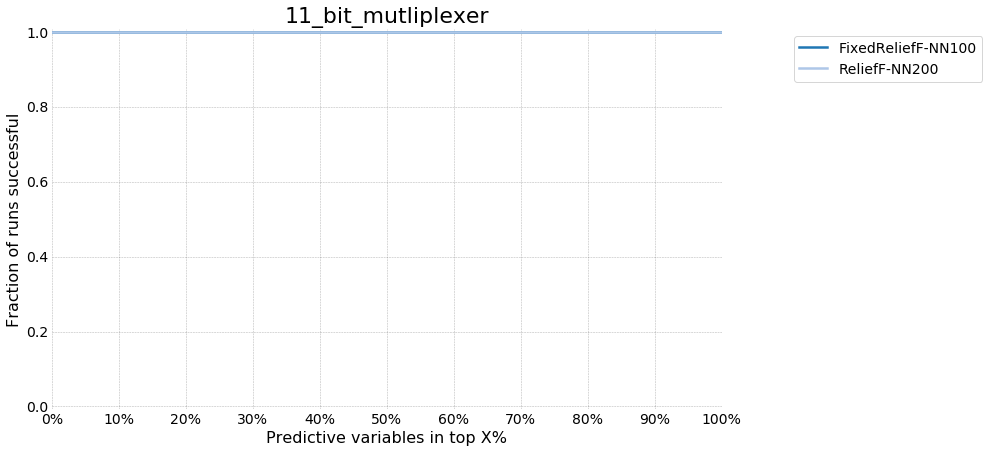

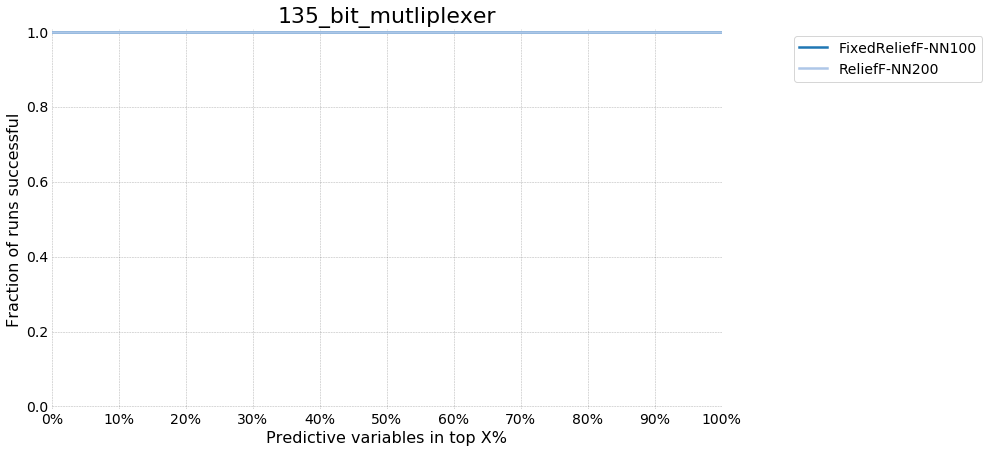

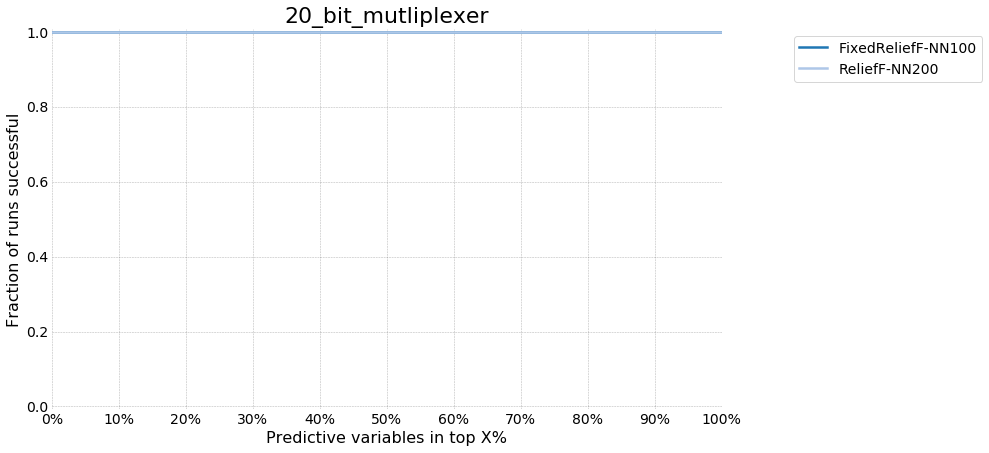

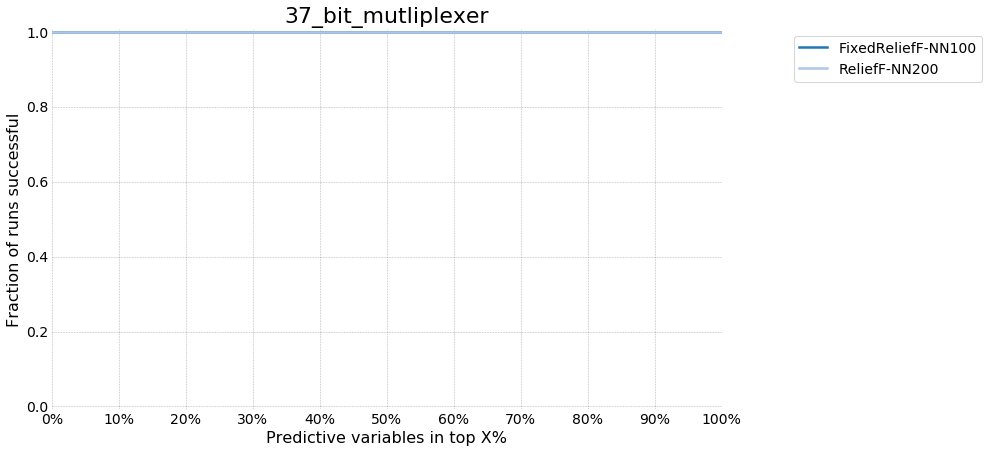

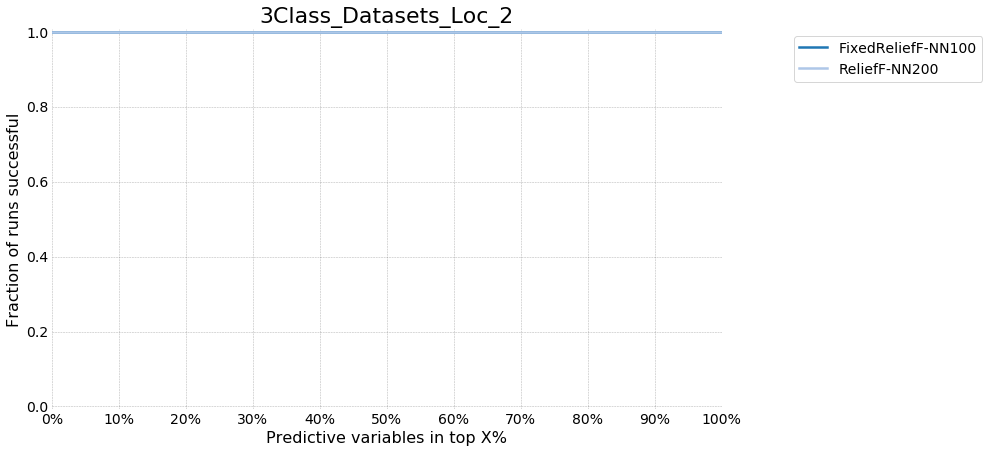

...

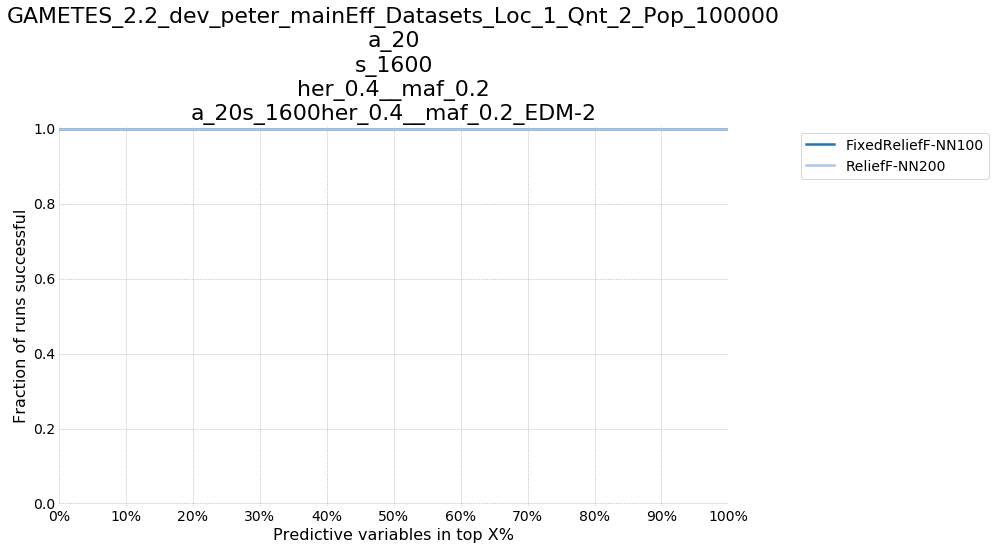

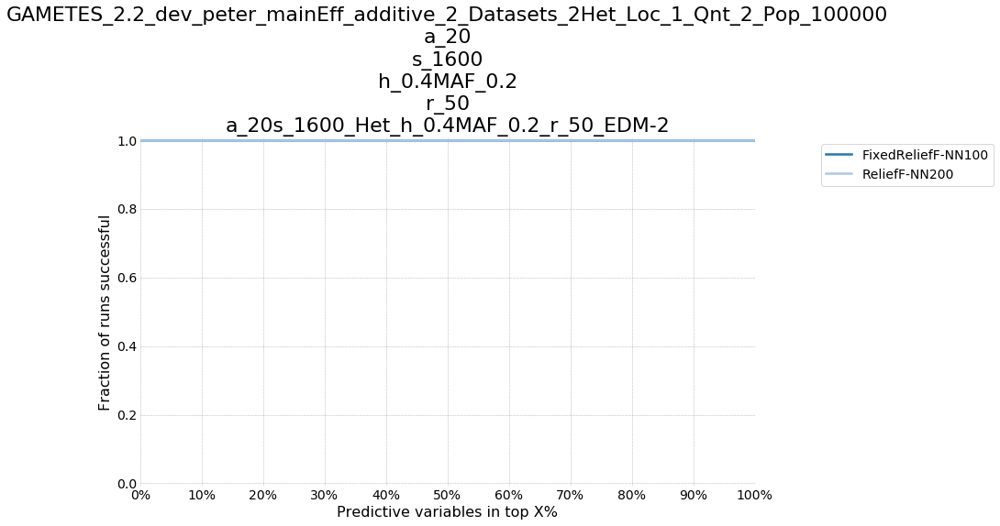

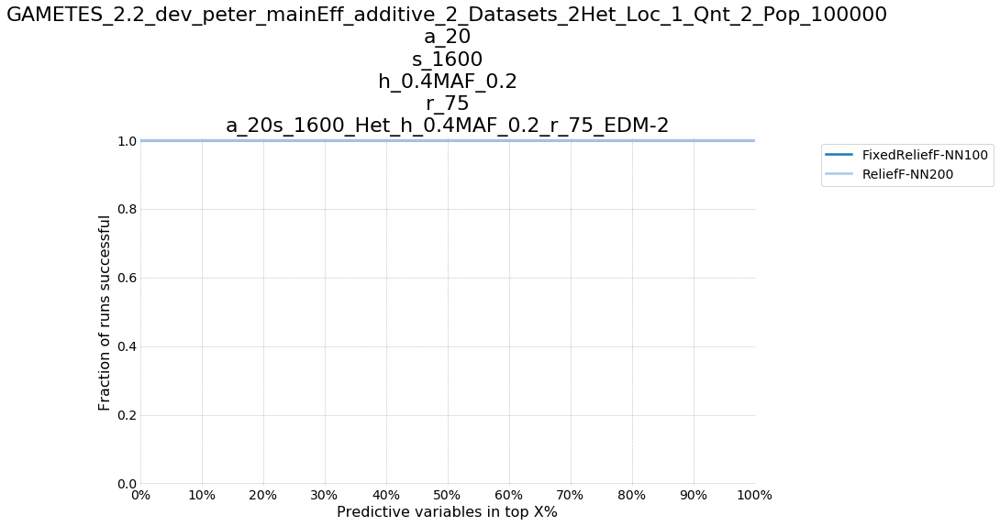

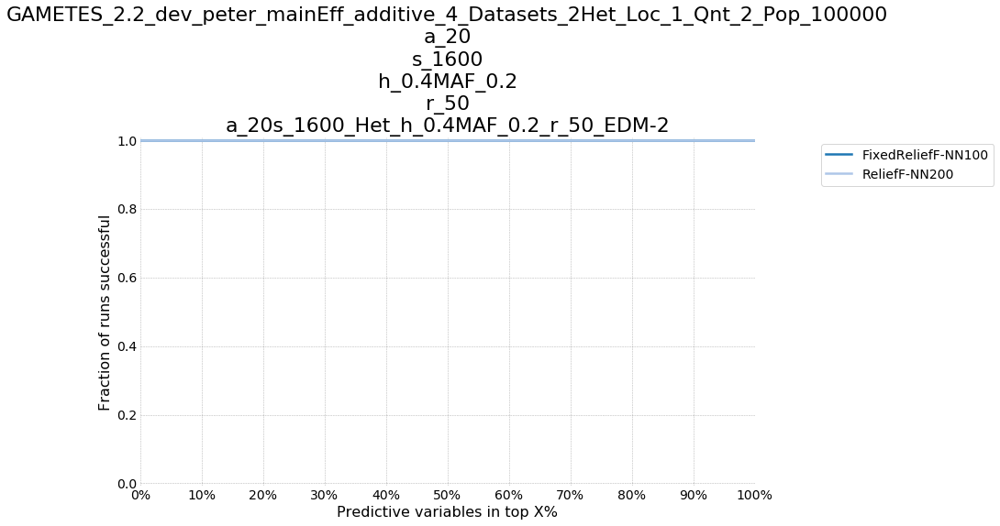

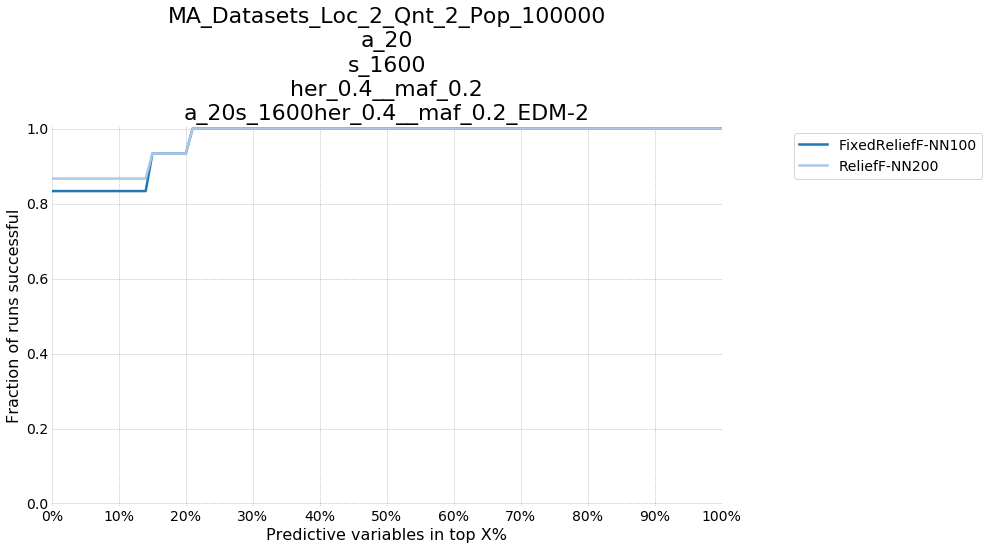

In [7]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

for problem, problem_group in benchmark_data_merged.groupby('FilePath'):
    problem_group_avg = problem_group.groupby('AlgorithmShort')[solved_cols].mean()
    #print(problem_group_avg.index.values)
    #print(problem_group_avg.columns.values)
    #print(problem_group_avg.values)
    
    plt.figure()
    for algorithm, vals in zip(problem_group_avg.index.values, problem_group_avg.values):
        if 'FixedReliefF-NN100' not in algorithm and 'ReliefF-NN200' not in algorithm:
            continue
        plt.plot(list(range(101)), vals, label=algorithm)

    plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))
    
    plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])
    
    plt.ylim(-0.0075, 1.0075)
    plt.xlim(0, 100)
    
    plt.ylabel('Fraction of runs successful')
    plt.xlabel('Predictive variables in top X%')
    plt.title('\n'.join(problem.split('Archive/')[-1].split('/')))

## Comparing variations of MultiSURF

**FixedMultiSURF**: MultiSURF with inverted scoring, as described in the original paper

**MultiSURF**: MultiSURF with the same scoring as SURF

**MultiSURF***: Version of MultiSURF with same scoring as SURF but not "far" scoring

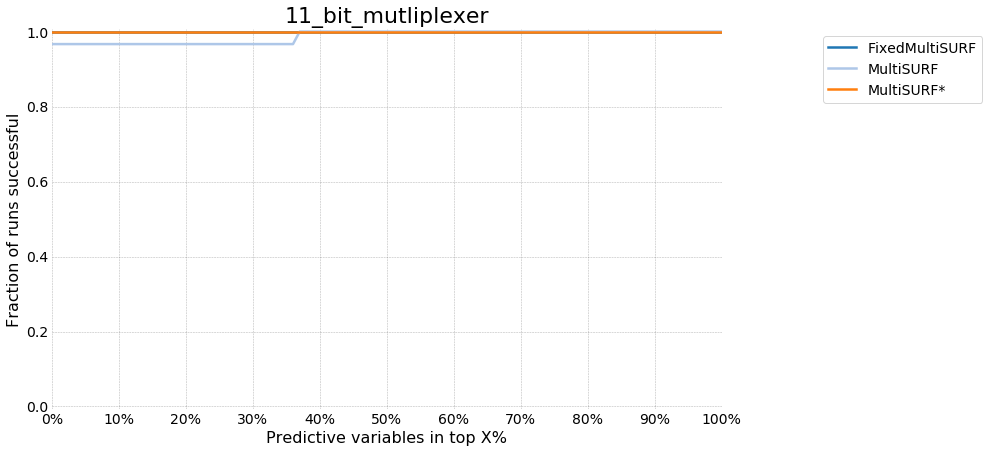

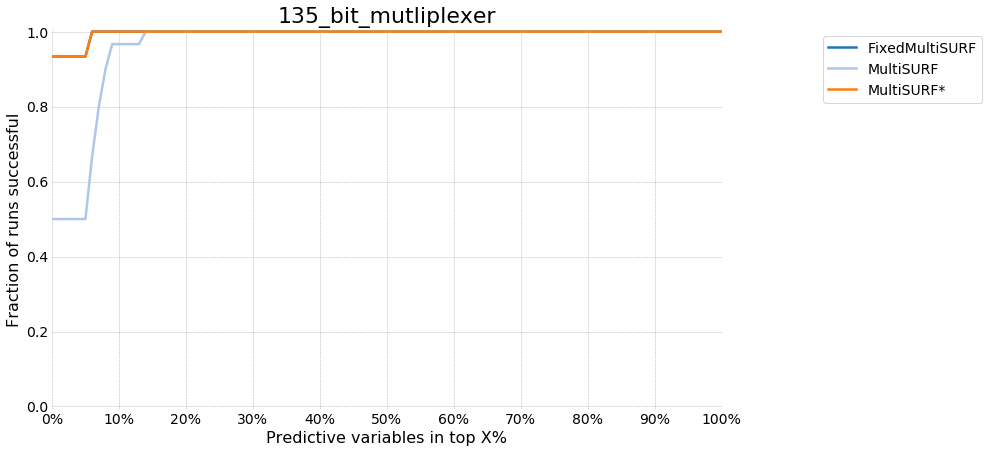

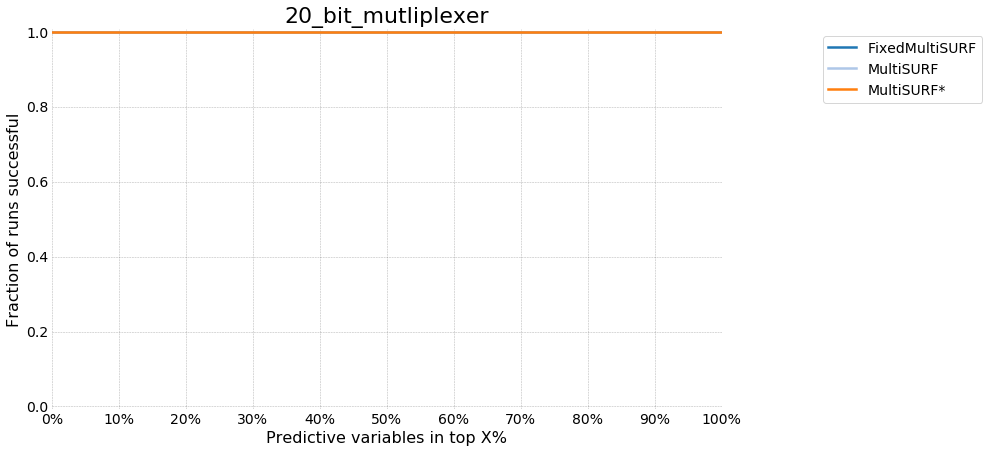

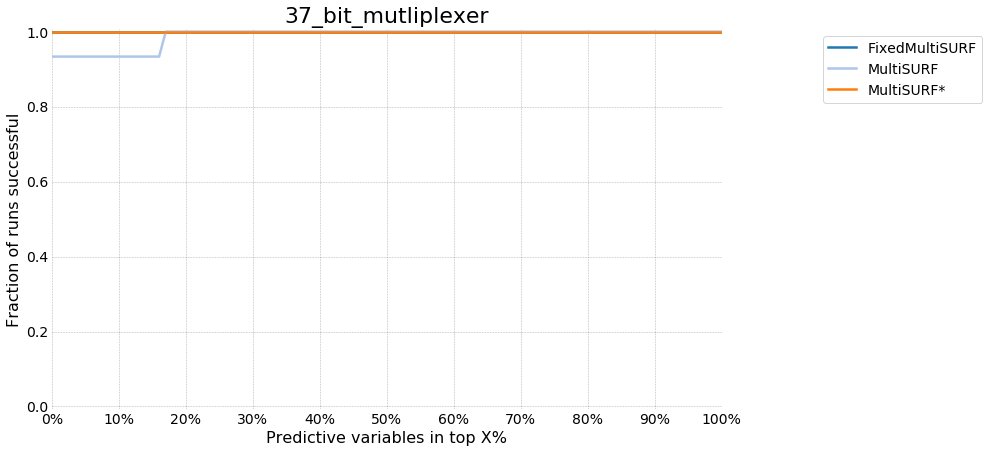

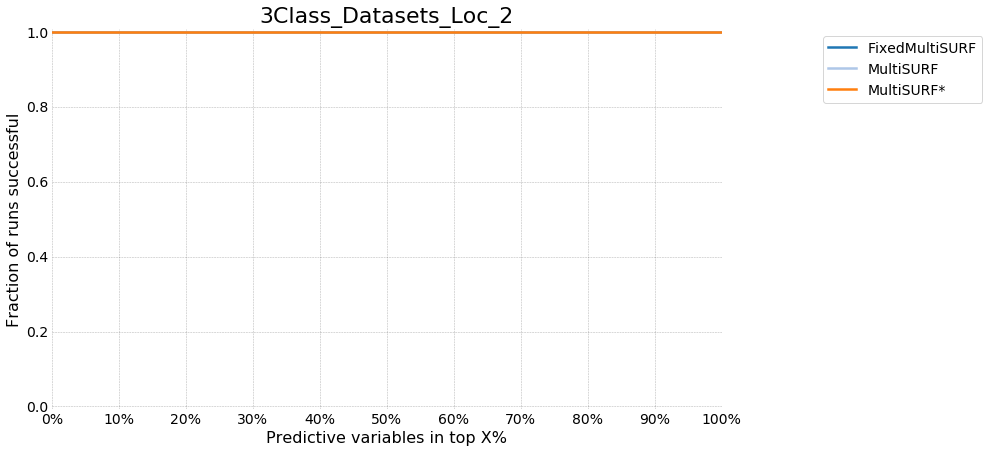

...

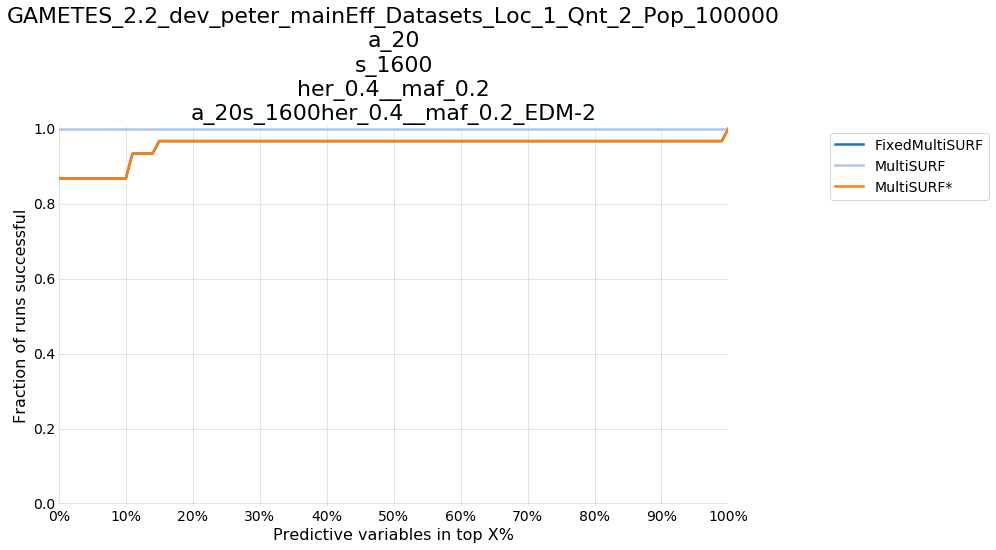

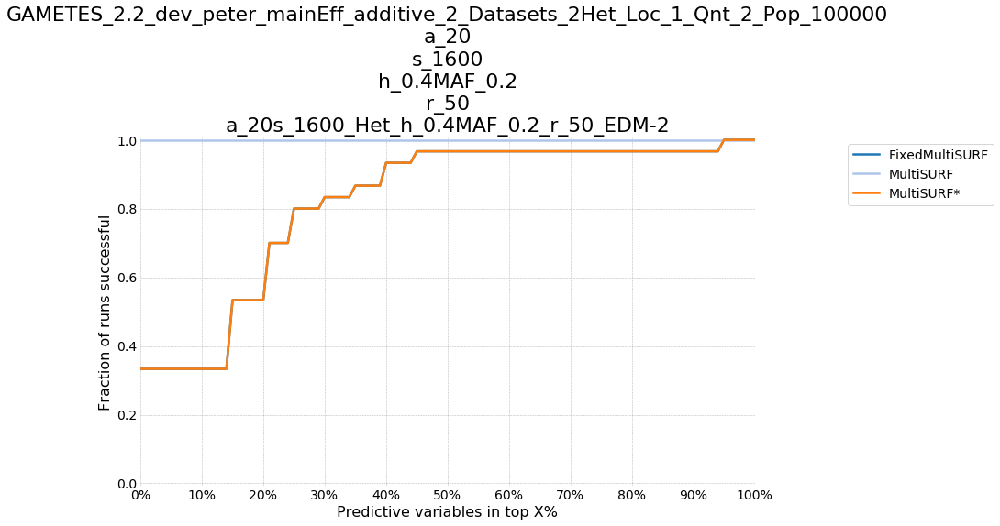

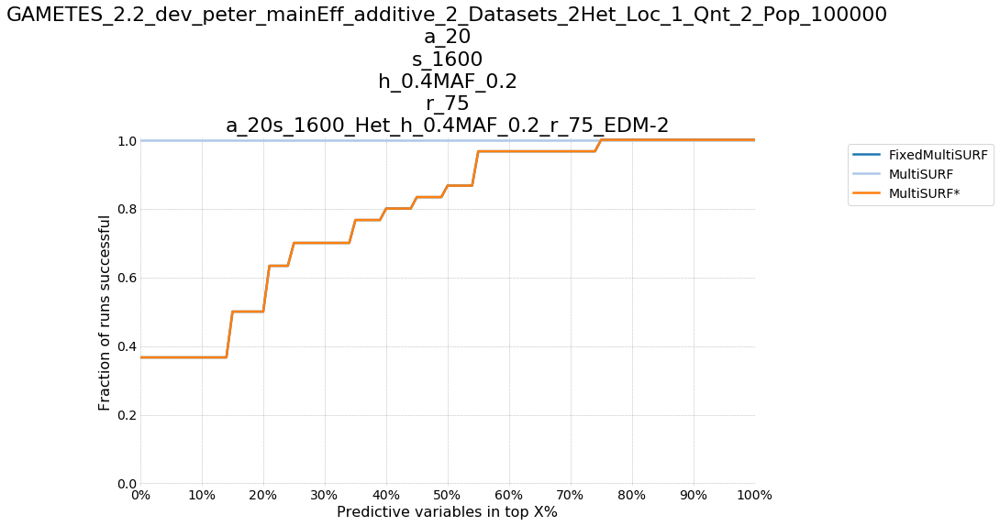

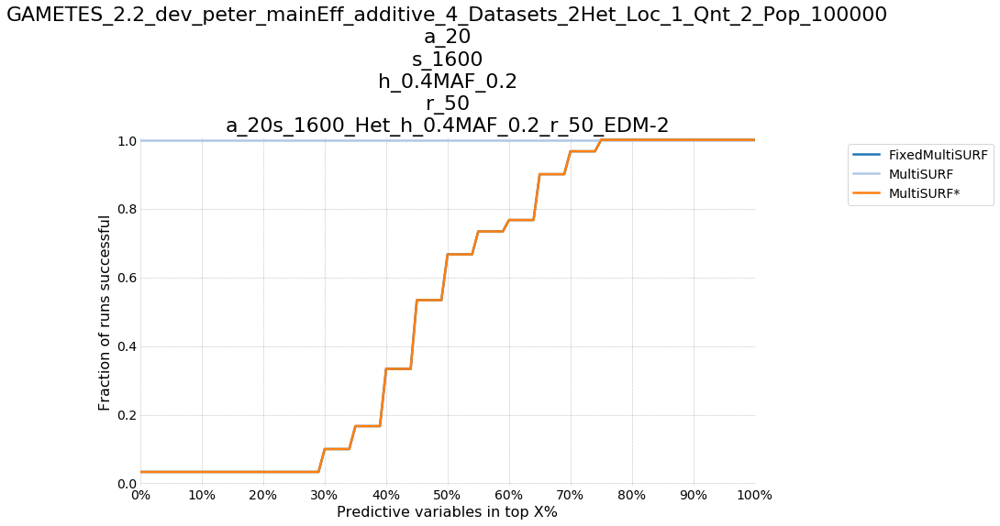

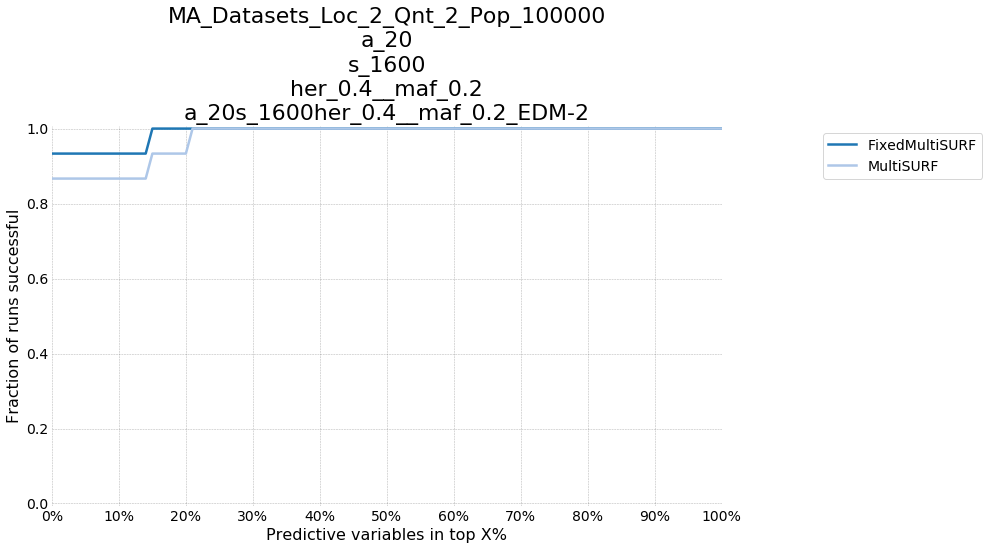

In [8]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

for problem, problem_group in benchmark_data_merged.groupby('FilePath'):
    problem_group_avg = problem_group.groupby('AlgorithmShort')[solved_cols].mean()
    #print(problem_group_avg.index.values)
    #print(problem_group_avg.columns.values)
    #print(problem_group_avg.values)
    
    plt.figure()
    for algorithm, vals in zip(problem_group_avg.index.values, problem_group_avg.values):
        if 'MultiSURF' not in algorithm:
            continue
        plt.plot(list(range(101)), vals, label=algorithm)

    plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))
    
    plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])
    
    plt.ylim(-0.0075, 1.0075)
    plt.xlim(0, 100)
    
    plt.ylabel('Fraction of runs successful')
    plt.xlabel('Predictive variables in top X%')
    plt.title('\n'.join(problem.split('Archive/')[-1].split('/')))

## Comparing the full REBATE set

**FixedMultiSURF**: MultiSURF with inverted scoring, as described in the original paper

**FixedReliefF-NN10**: ReliefF taking the 10 nearest neighbors (10 nearest matches & 10 nearest misses)

**FixedReliefF-NN100**: ReliefF taking the 100 nearest neighbors (100 nearest matches & 100 nearest misses)

**FixedReliefFPercent10**: ReliefF taking 10% of the data set size nearest neighbors (5% matches & 5% misses)

**FixedReliefFPercent20**: ReliefF taking 20% of the data set size nearest neighbors (1% matches & 1% misses)

**FixedReliefFPercent30**: ReliefF taking 30% of the data set size nearest neighbors (15% matches & 15% misses)

**FixedReliefFPercent38.2**: ReliefF taking 38.2% of the data set size nearest neighbors (19.1% matches & 19.1% misses)

**FixedReliefFPercent50**: ReliefF taking 50% of the data set size nearest neighbors (25% matches & 25% misses)

**MultiSURF**: MultiSURF with the same scoring as SURF

**MultiSURF***: Version of MultiSURF with same scoring as SURF but not "far" scoring

**ReliefF-NN10**: ReliefF taking the 10 nearest neighbors (regardless of match/miss)

**ReliefF-NN100**: ReliefF taking the 100 nearest neighbors (regardless of match/miss)

**ReliefF-NN200**: ReliefF taking the 200 nearest neighbors (regardless of match/miss)

**SURF**: Regular SURF as described in the paper

**SURFstar**: Regular SURF* as described in the paper

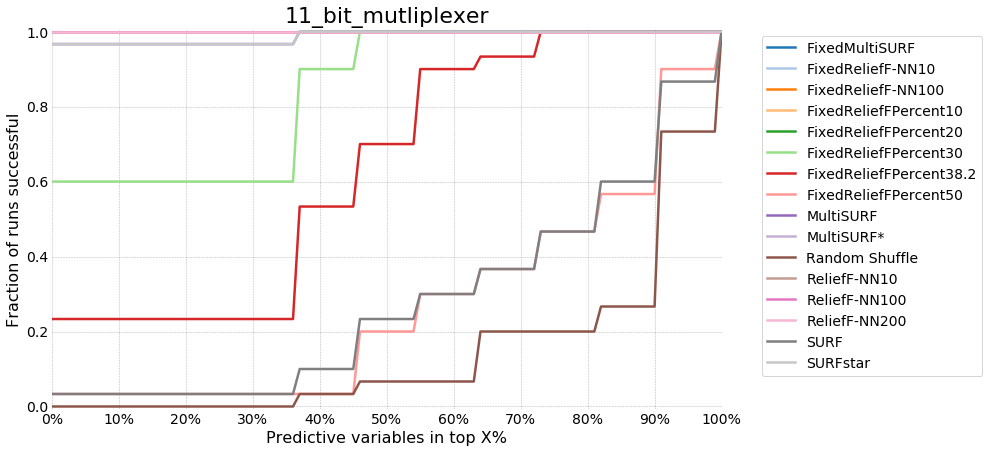

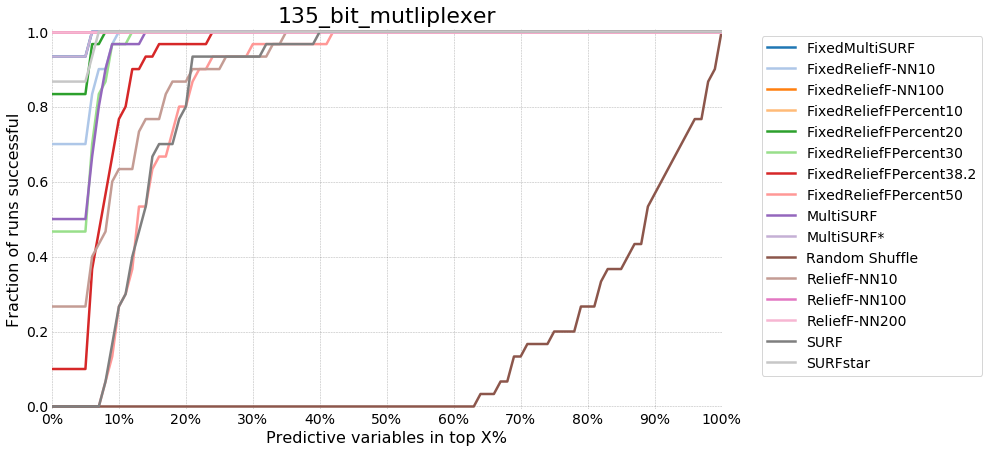

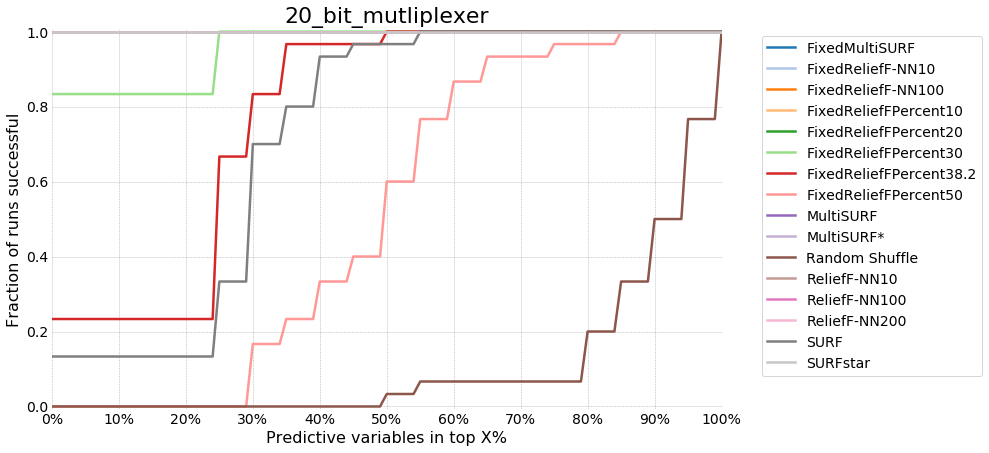

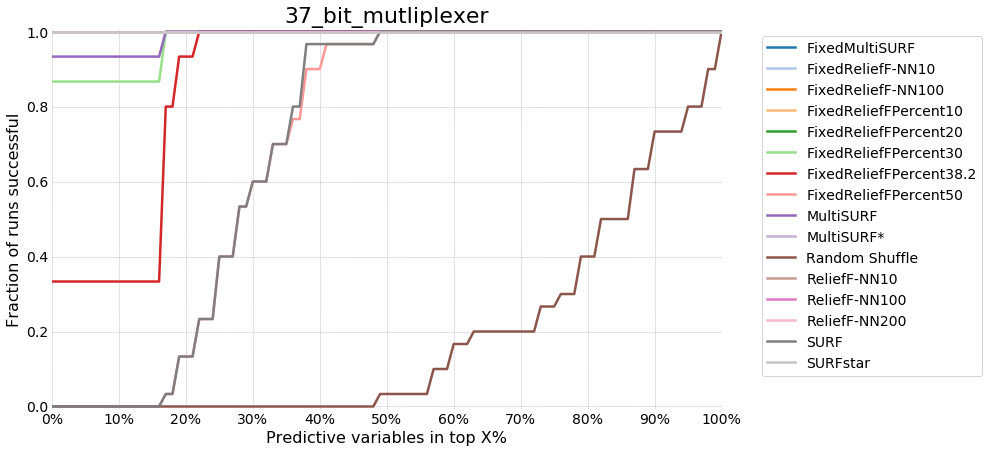

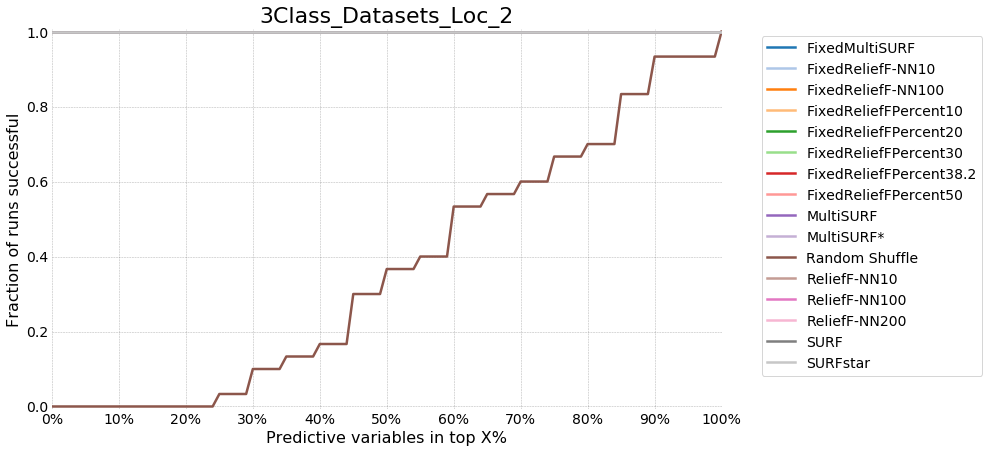

...

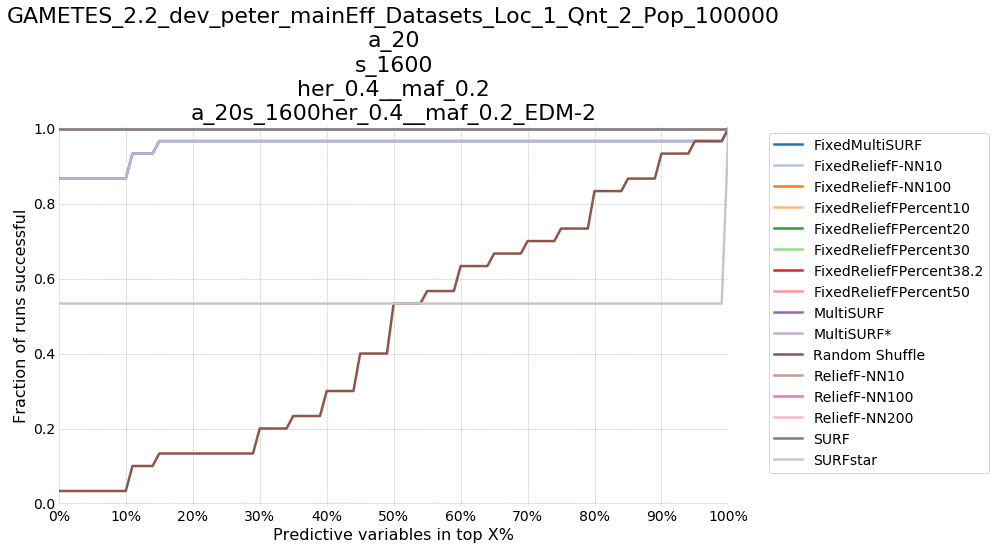

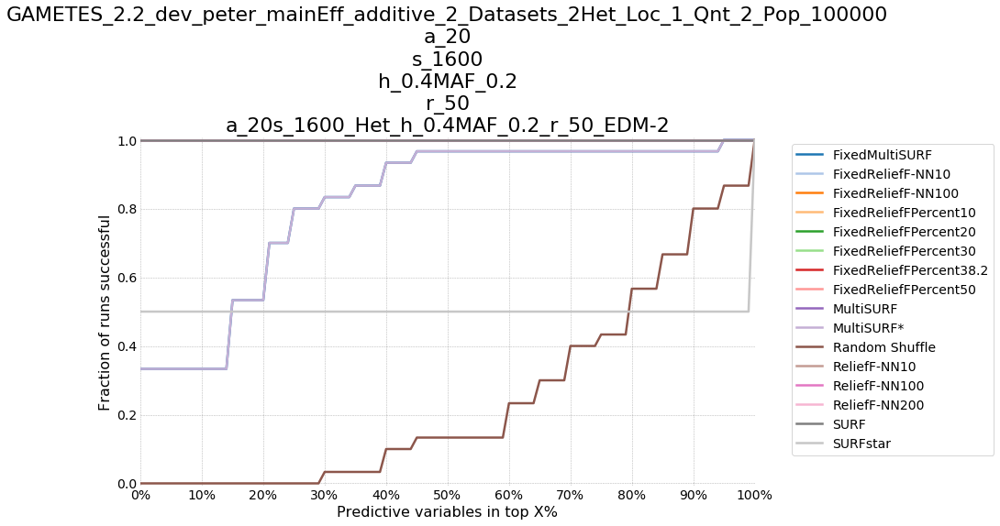

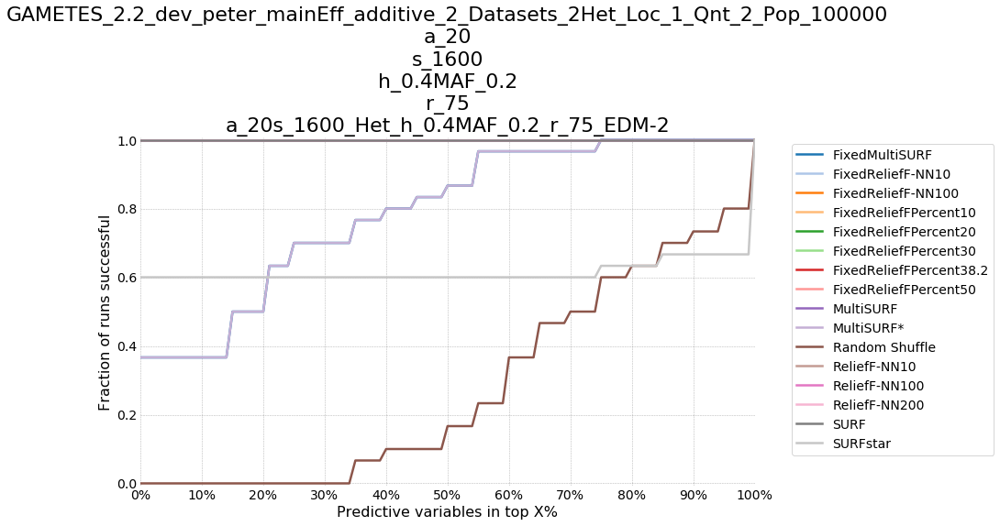

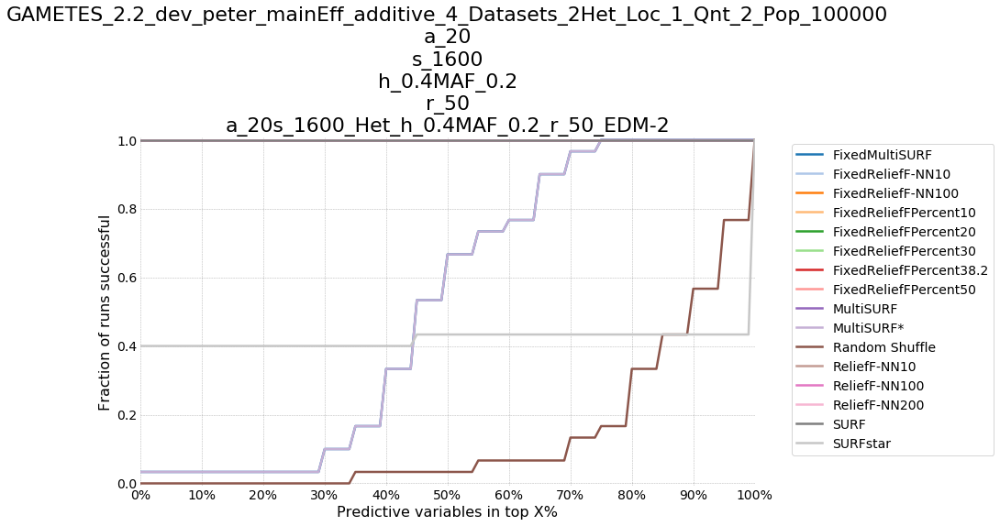

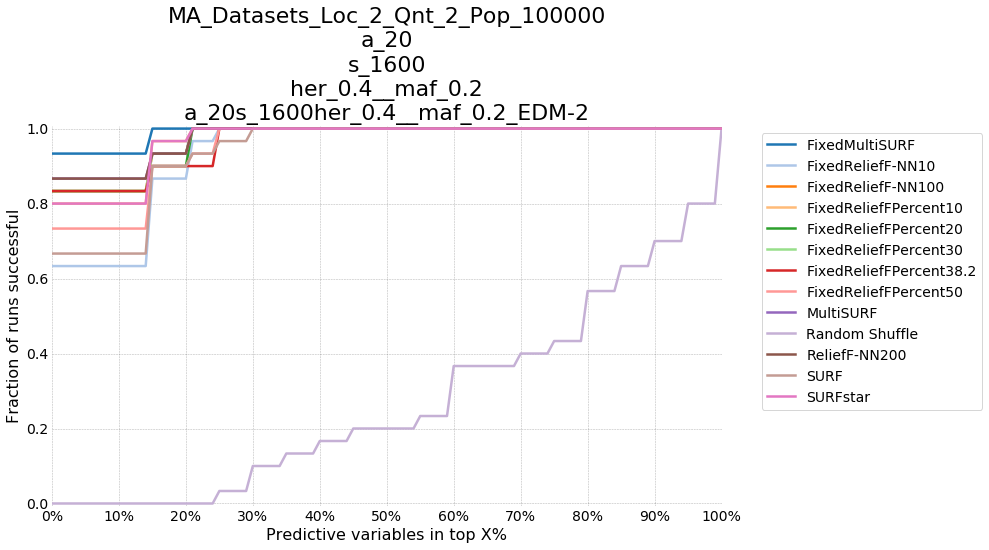

In [9]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

for problem, problem_group in benchmark_data_merged.groupby('FilePath'):
    problem_group_avg = problem_group.groupby('AlgorithmShort')[solved_cols].mean()
    #print(problem_group_avg.index.values)
    #print(problem_group_avg.columns.values)
    #print(problem_group_avg.values)
    
    plt.figure()
    for algorithm, vals in zip(problem_group_avg.index.values, problem_group_avg.values):
        if algorithm in ['ANOVAFValue', 'ExtraTrees', 'MutualInformation',
                         'RFEExtraTrees', 'chi2']:
            continue
        plt.plot(list(range(101)), vals, label=algorithm)

    plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))
    
    plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])
    
    plt.ylim(-0.0075, 1.0075)
    plt.xlim(0, 100)
    
    plt.ylabel('Fraction of runs successful')
    plt.xlabel('Predictive variables in top X%')
    plt.title('\n'.join(problem.split('Archive/')[-1].split('/')))
    #plt.savefig('figures/' + problem.split('Archive/')[-1].replace('/', '_') + '.pdf', bbox_inches='tight')

## Comparing the standard feature selection methods

/Users/randal_olson/anaconda/lib/python3.6/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


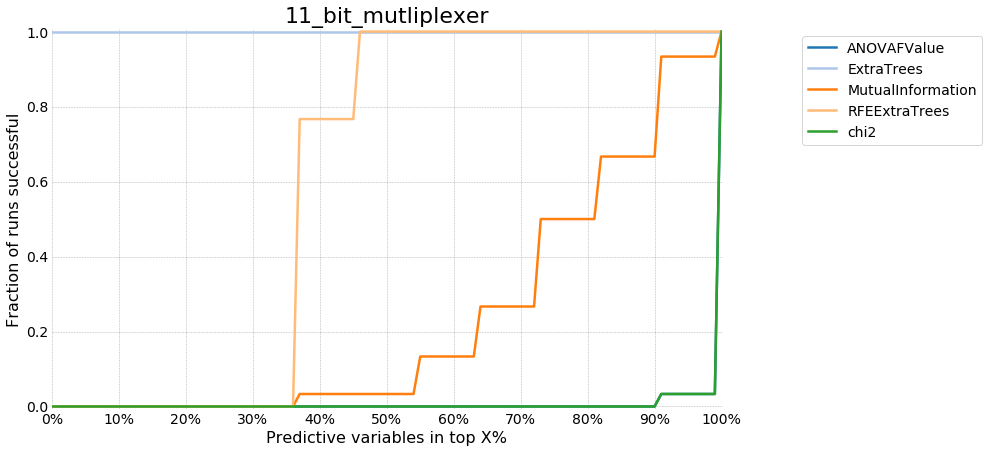

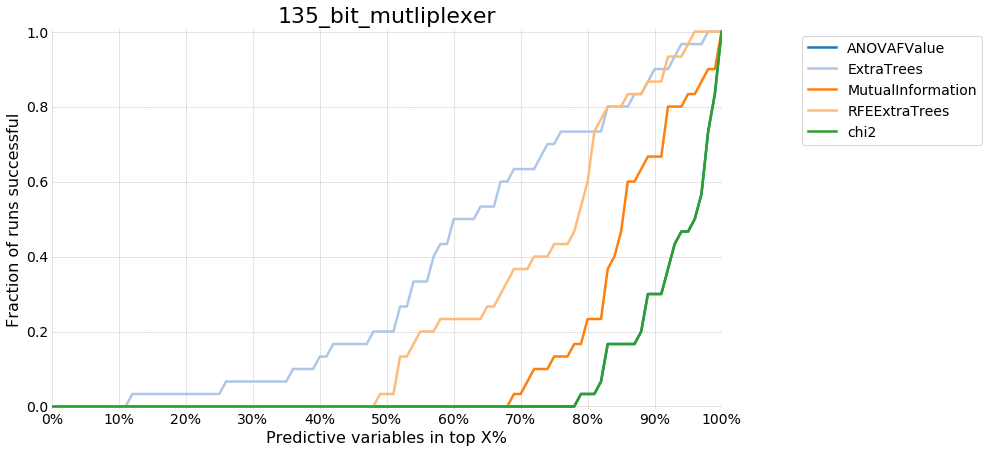

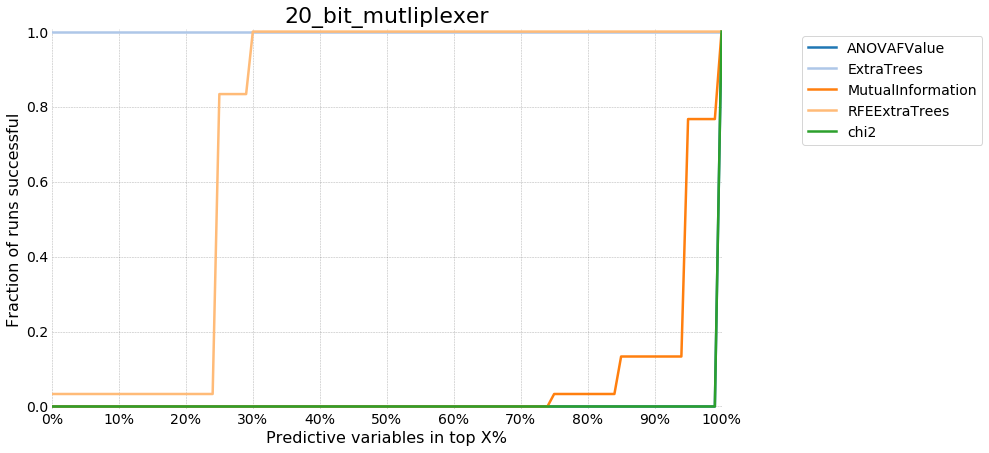

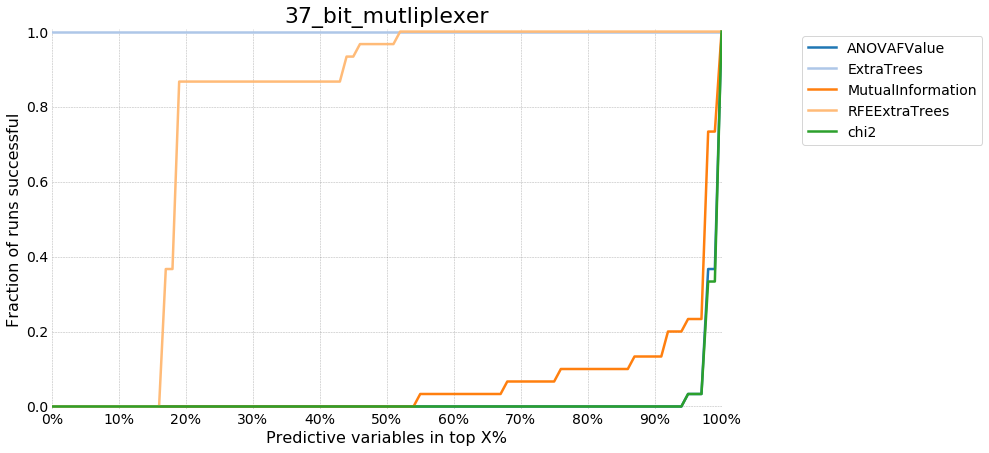

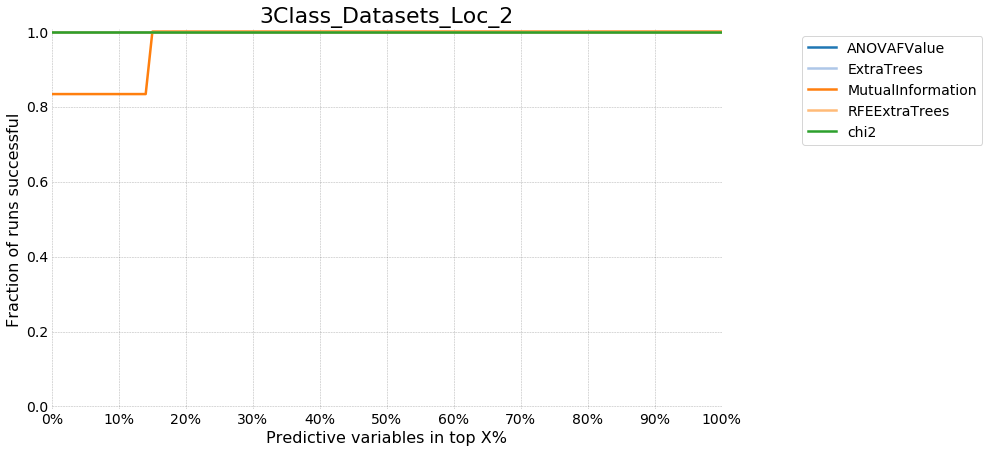

...

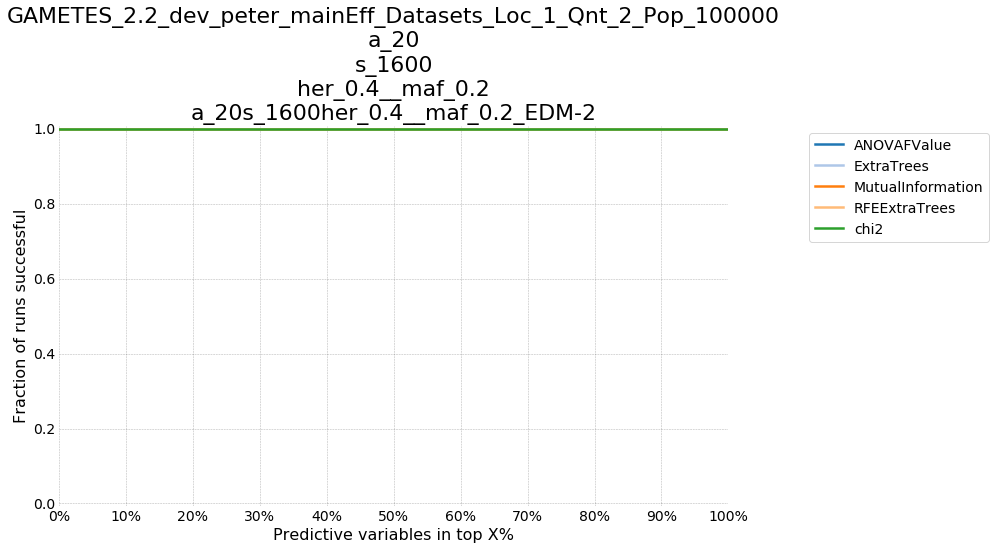

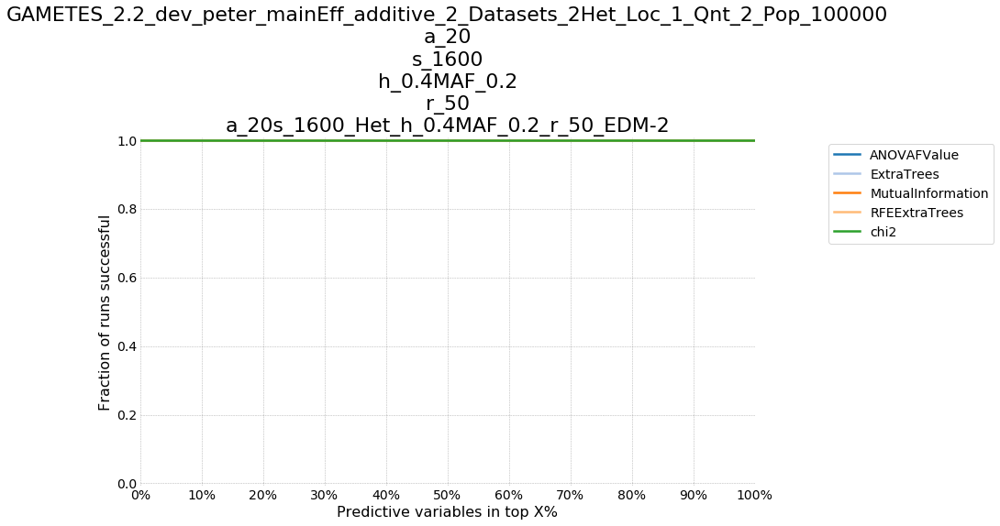

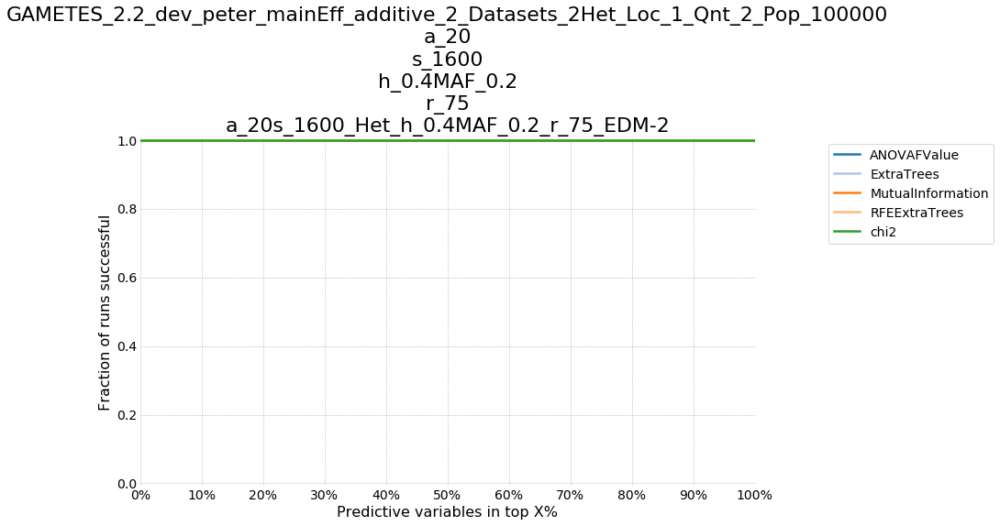

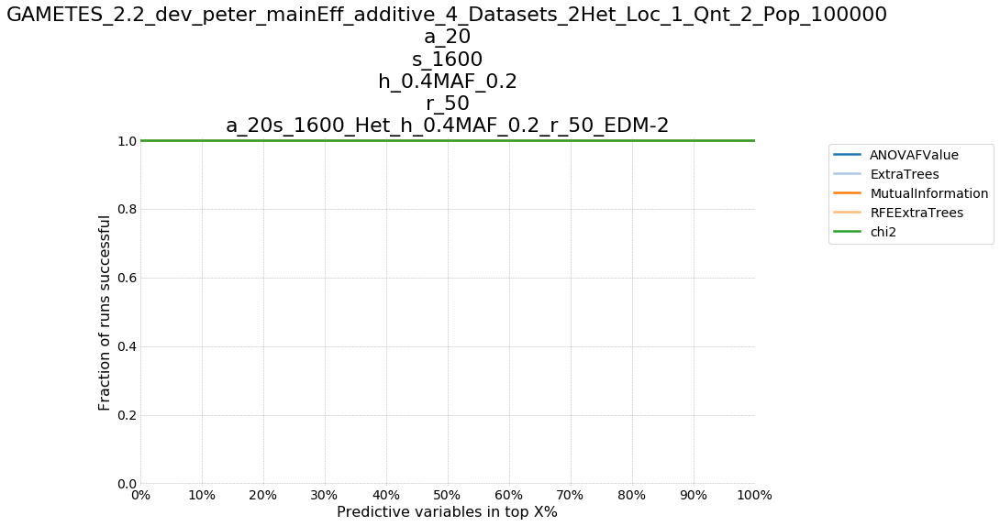

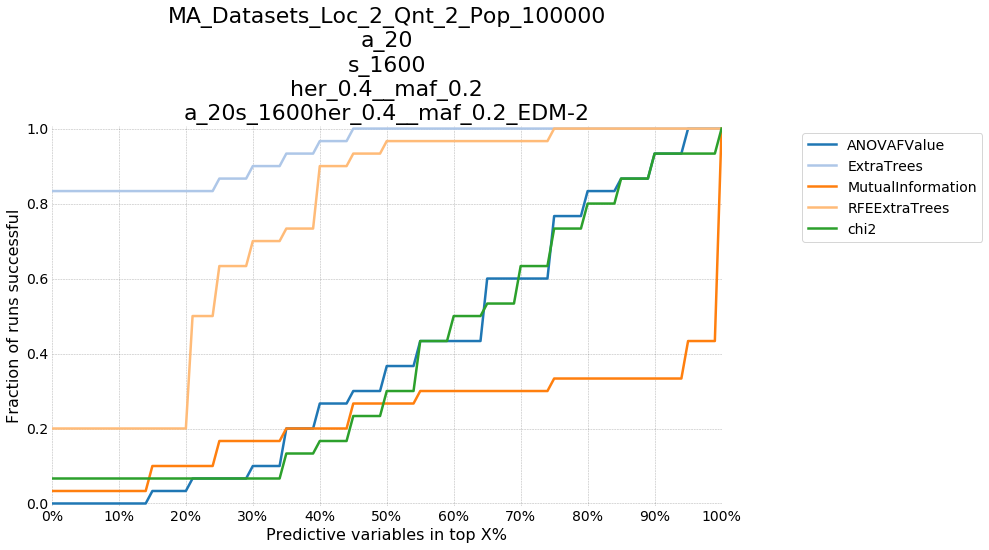

In [10]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

for problem, problem_group in benchmark_data_merged.groupby('FilePath'):
    problem_group_avg = problem_group.groupby('AlgorithmShort')[solved_cols].mean()
    
    plt.figure()
    for algorithm, vals in zip(problem_group_avg.index.values, problem_group_avg.values):
        if algorithm not in ['ANOVAFValue', 'ExtraTrees', 'MutualInformation',
                             'RFEExtraTrees', 'chi2', 'MultiSURF*']:
            continue
        plt.plot(list(range(101)), vals, label=algorithm)

    plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))
    
    plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])
    
    plt.ylim(-0.0075, 1.0075)
    plt.xlim(0, 100)
    
    plt.ylabel('Fraction of runs successful')
    plt.xlabel('Predictive variables in top X%')
    plt.title('\n'.join(problem.split('Archive/')[-1].split('/')))
    #plt.savefig('figures/' + problem.split('Archive/')[-1].replace('/', '_') + '.pdf', bbox_inches='tight')

/Users/randal_olson/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
/Users/randal_olson/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


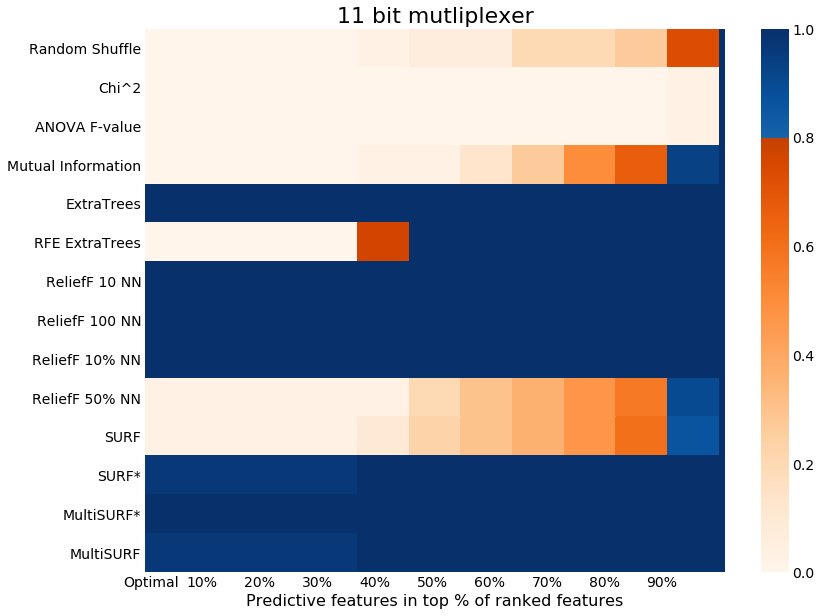

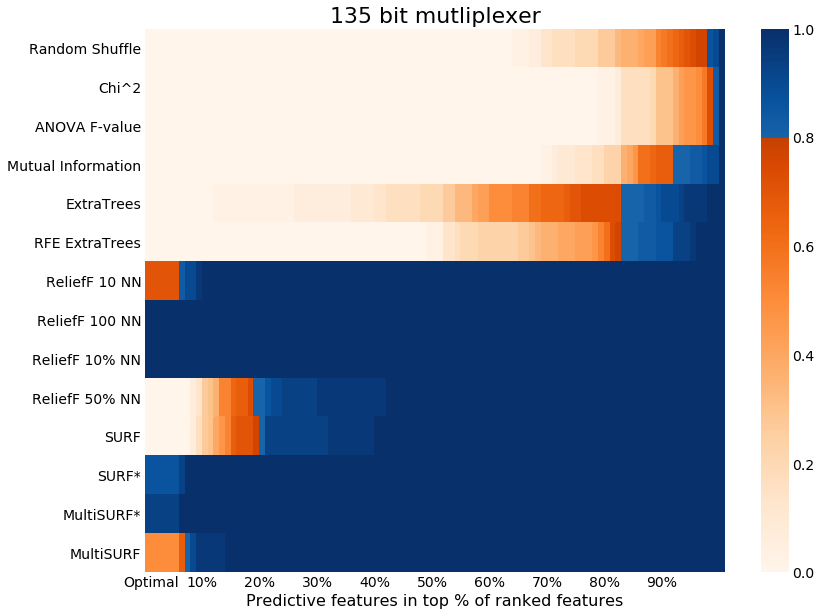

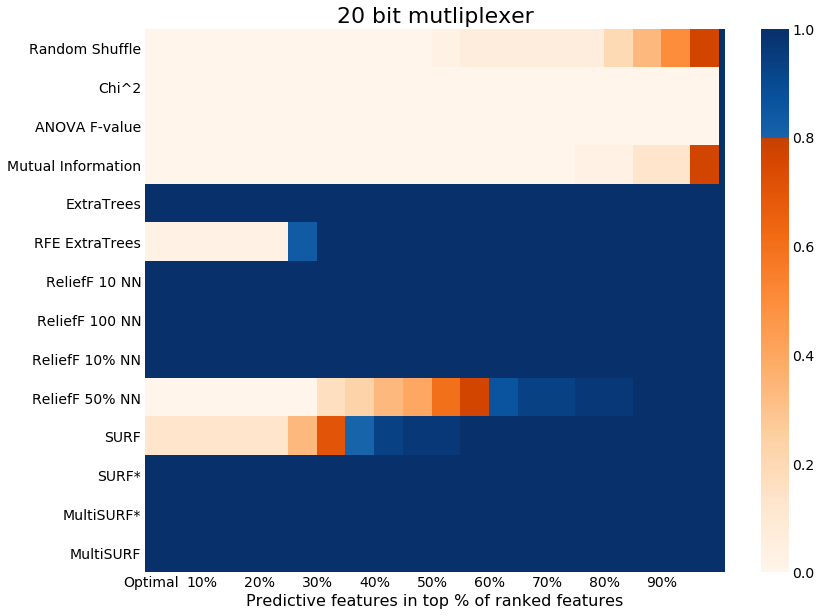

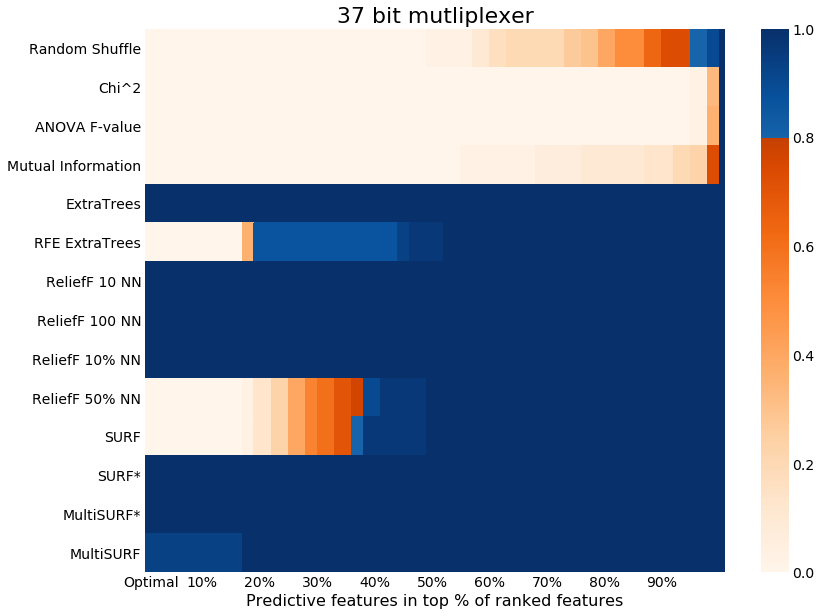

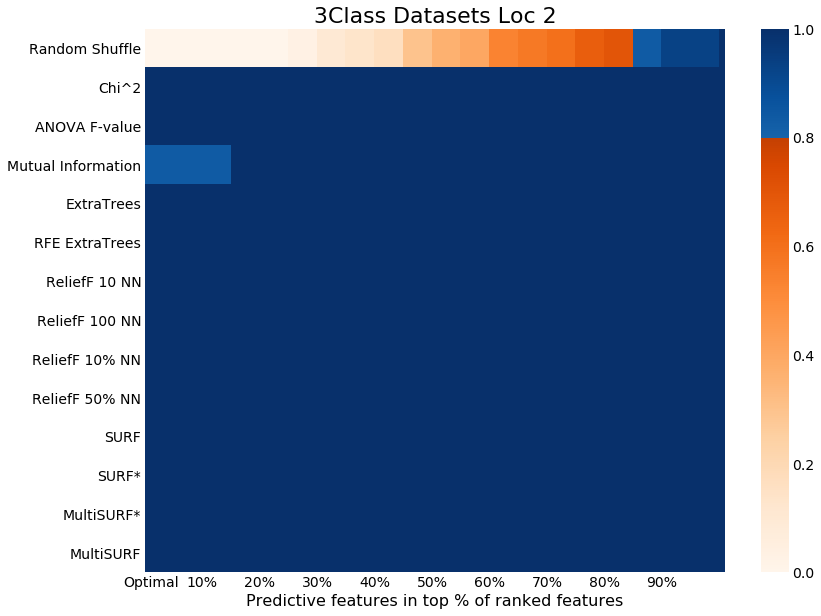

...

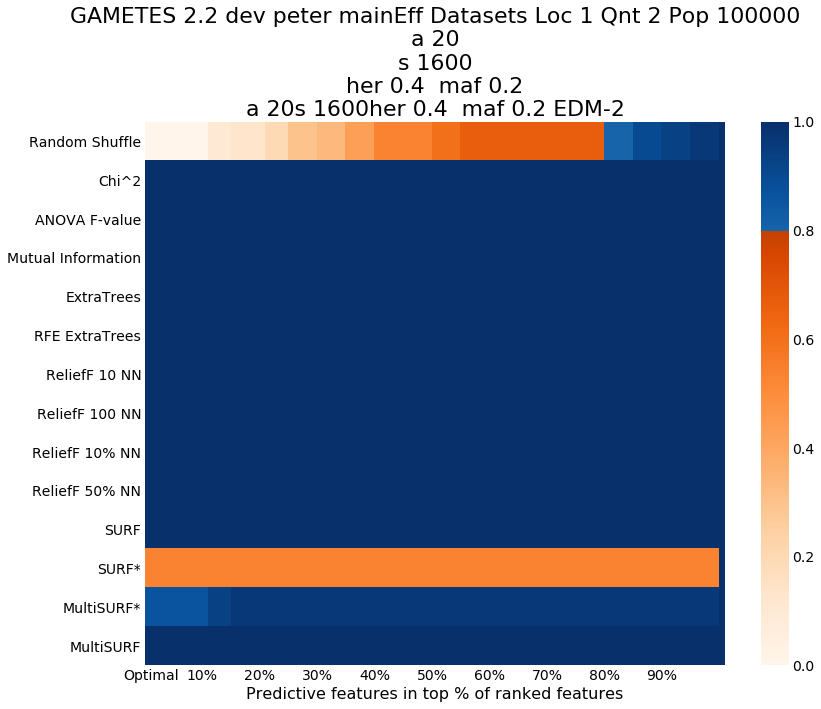

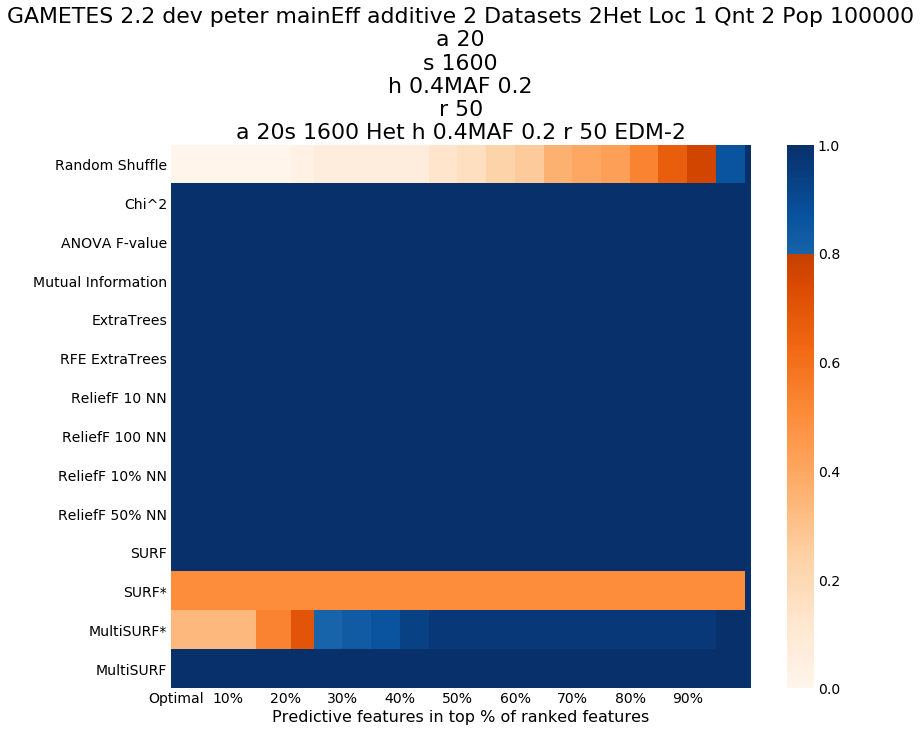

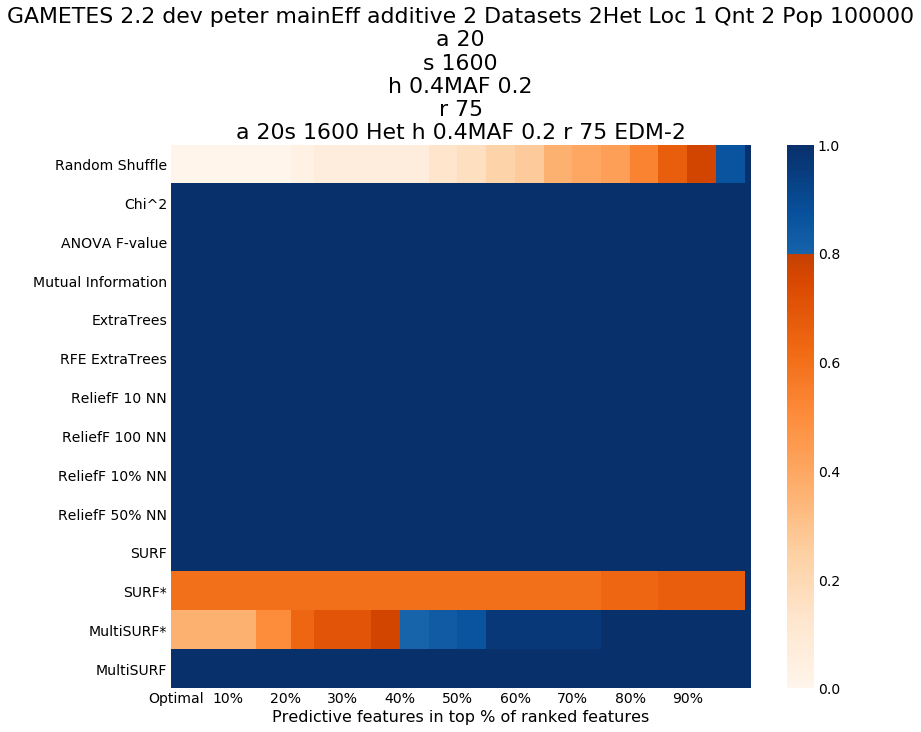

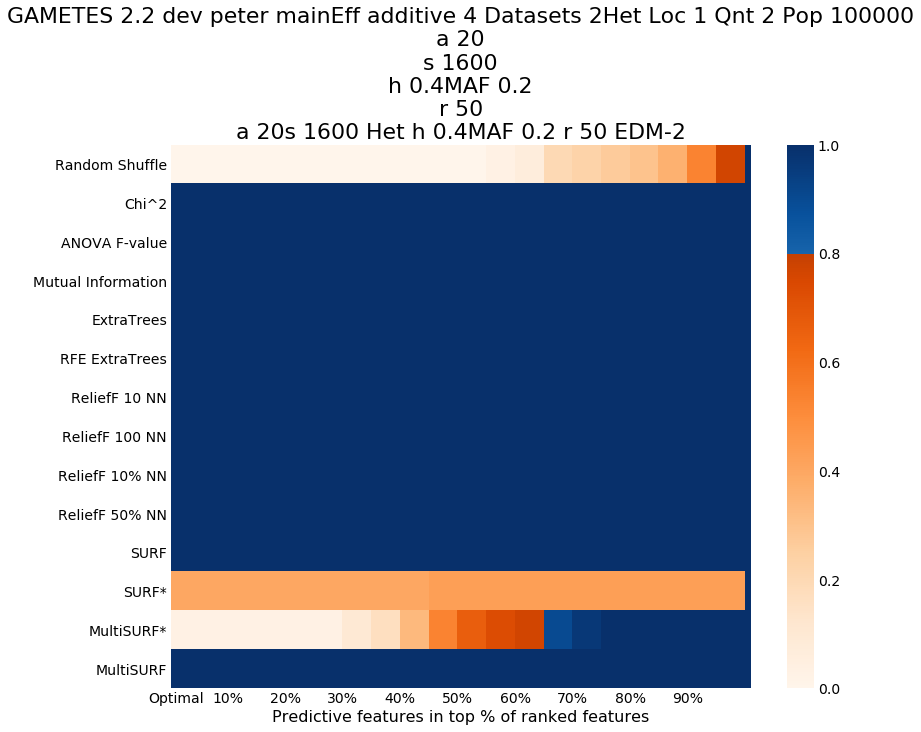

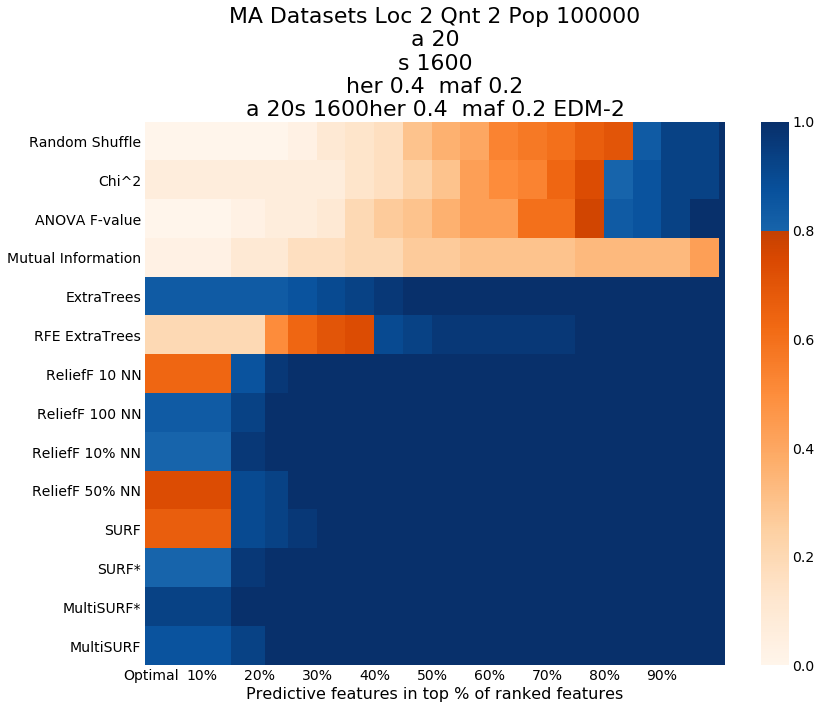

In [88]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

import seaborn as sb
import numpy as np

for problem, problem_group in benchmark_data_merged.groupby('FilePath'):
    problem_group = problem_group.loc[problem_group['AlgorithmShort'].apply(
        lambda x: x not in ['MultiSURF*', 'FixedReliefFPercent20', 'FixedReliefFPercent30',
                            'FixedReliefFPercent38.2',
                            'ReliefF-NN10', 'ReliefF-NN100', 'ReliefF-NN200'])]

    problem_group['AlgorithmShort'] = problem_group['AlgorithmShort'].apply(
        lambda x: x.replace('ANOVAFValue', 'ANOVA F-value')
                   .replace('FixedMultiSURF', 'MultiSURF*') # FixedMultiSURF == MultiSURF*
                   .replace('Fixed', '').replace('chi2', 'Chi^2')
                   .replace('SURFstar', 'SURF*').replace('ReliefFPercent50', 'ReliefF 50% NN')
                   .replace('ReliefFPercent10', 'ReliefF 10% NN').replace('ReliefF-NN100', 'ReliefF 100 NN')
                   .replace('ReliefF-NN10', 'ReliefF 10 NN').replace('RFEExtraTrees', 'RFE ExtraTrees')
                   .replace('MutualInformation', 'Mutual Information'))
    
    algo_labels = ['Random Shuffle',
                   'Chi^2',
                   'ANOVA F-value',
                   'Mutual Information', 
                   'ExtraTrees',
                   'RFE ExtraTrees',
                   'ReliefF 10 NN',
                   'ReliefF 100 NN',
                   'ReliefF 10% NN',
                   'ReliefF 50% NN',
                   'SURF',
                   'SURF*',
                   'MultiSURF*',
                   'MultiSURF'][::-1]
    
    problem_group['AlgorithmShort'] = pd.Categorical(problem_group['AlgorithmShort'],
                                                     algo_labels)

    problem_group_avg = problem_group.groupby(
        'AlgorithmShort')[solved_cols].mean().sort_index(ascending=False)

    plt.figure(figsize=(13, 10))
    
    custom_cmap = sb.color_palette('Oranges', n_colors=1000)[:800] + sb.color_palette('Blues', n_colors=1000)[800:]
    sb.heatmap(data=problem_group_avg.values, vmin=0, vmax=1, cmap=custom_cmap)#'Blues')
    plt.yticks(np.array(range(len(problem_group_avg))) + 0.5, algo_labels[::-1], rotation=0)
    plt.xticks([1, 10, 20, 30, 40, 50, 60, 70, 80, 90],
               ['Optimal', '10%', '20%', '30%', '40%', '50%', '60%', '70%', '80%', '90%'], rotation=0)
    plt.xlabel('Predictive features in top % of ranked features')
    plt.title('\n'.join(problem.split('Archive/')[-1].split('/')).replace('_', ' '))
    
    plt.savefig('figures/' + problem.split('Archive/')[-1].replace('/', '_') + '.pdf', bbox_inches='tight')
    plt.savefig('figures/' + problem.split('Archive/')[-1].replace('/', '_') + '.eps', bbox_inches='tight')

## Comparing the overall performance of the standard feature selection methods

''

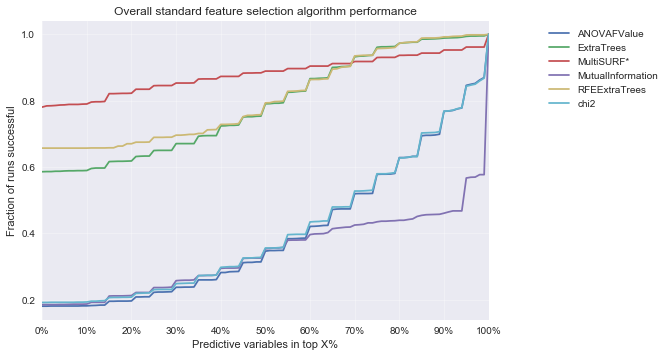

In [24]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

algorithm_group_avg = benchmark_data_merged.groupby('AlgorithmShort')[solved_cols].mean()

plt.figure()
for algorithm, vals in zip(algorithm_group_avg.index.values, algorithm_group_avg.values):
    if algorithm not in ['ANOVAFValue', 'ExtraTrees', 'MutualInformation',
                         'RFEExtraTrees', 'chi2', 'MultiSURF*']:
        continue
    plt.plot(list(range(101)), vals, label=algorithm)

plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))

plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])

#plt.ylim(-0.0075, 1.0075)
plt.xlim(0, 100)

plt.ylabel('Fraction of runs successful')
plt.xlabel('Predictive variables in top X%')
plt.title('Overall standard feature selection algorithm performance')
;

## Comparing the overall performance of the ReliefF variations

''

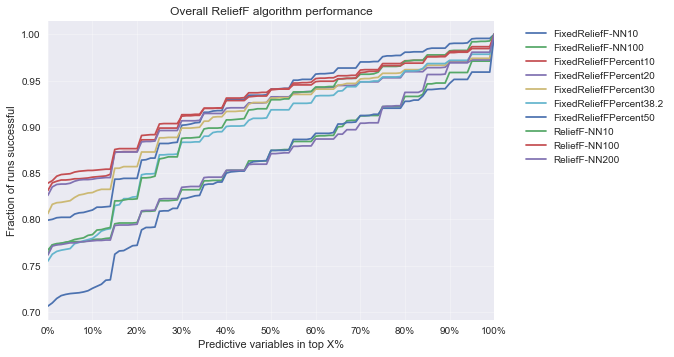

In [17]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

algorithm_group_avg = benchmark_data_merged.groupby('AlgorithmShort')[solved_cols].mean()

plt.figure()
for algorithm, vals in zip(algorithm_group_avg.index.values, algorithm_group_avg.values):
    if 'ReliefF' not in algorithm:
        continue
    plt.plot(list(range(101)), vals, label=algorithm)

plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))

plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])

#plt.ylim(-0.0075, 1.0075)
plt.xlim(0, 100)

plt.ylabel('Fraction of runs successful')
plt.xlabel('Predictive variables in top X%')
plt.title('Overall ReliefF algorithm performance')
;

## Comparing the overall performance of all of the REBATE variations

''

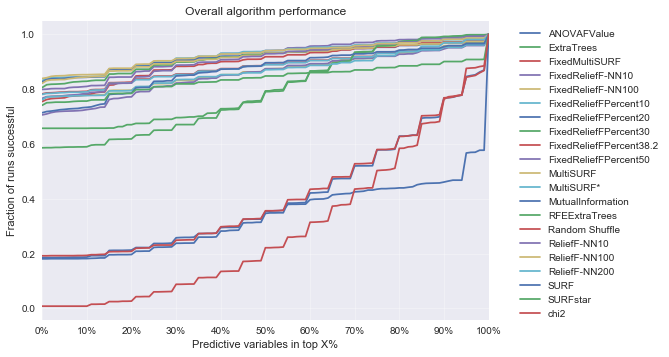

In [18]:
solved_cols = [x for x in benchmark_data_merged.columns.values if 'Solved' in x]

algorithm_group_avg = benchmark_data_merged.groupby('AlgorithmShort')[solved_cols].mean()

plt.figure()
for algorithm, vals in zip(algorithm_group_avg.index.values, algorithm_group_avg.values):
    plt.plot(list(range(101)), vals, label=algorithm)

plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1))

plt.xticks(list(range(101))[::-10], ['{}%'.format(x) for x in list(range(101))[::-10]])

#plt.ylim(-0.0075, 1.0075)
plt.xlim(0, 100)

plt.ylabel('Fraction of runs successful')
plt.xlabel('Predictive variables in top X%')
plt.title('Overall algorithm performance')
#plt.savefig('figures/overall.pdf', bbox_inches='tight')
;